
**L'objectif**:  est de produire un modèle de classification multi-classes des images en utilisant des techniques d'apprentissage profond telles que les réseaux neuronaux convolutifs (CNN). Ces expérimentations visent à optimiser les performances du modèle en termes de précision, de rappel et de F1-score pour répondre aux exigences spécifiques de la tâche de classification d'images.

In [ ]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import numpy as np
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import layers, models, optimizers
import random

**Chargement des images & prétraitement des images**

In [ ]:
# redimentionné les images et les enrégistré 

In [ ]:
# Chemin vers le répertoire contenant les images à redimensionner
input_dir = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Chao"
input_dir1 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Ervas"
input_dir2 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Milho"
input_dir3 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Chao"
input_dir4 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Ervas"
input_dir5 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Milho"
input_dir6 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Chao"
input_dir7 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Ervas"
input_dir8 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Milho"

# Chemin vers le répertoire de sortie où les images redimensionnées seront enregistrées
output_dir = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Chao1"
output_dir1 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Ervas1"
output_dir2 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Milho1"
output_dir3 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Chao1"
output_dir4 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Ervas1"
output_dir5 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Milho1"
output_dir6 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Chao1"
output_dir7 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Ervas1"
output_dir8 = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Milho1"

# Taille cible pour le redimensionnement
target_size = (256, 256)  # Nouvelle taille : 256x256 pixels

# Assurez-vous que les répertoires de sortie existent, sinon, créez-les
os.makedirs(output_dir, exist_ok=True)
os.makedirs(output_dir1, exist_ok=True)
os.makedirs(output_dir2, exist_ok=True)
os.makedirs(output_dir3, exist_ok=True)
os.makedirs(output_dir4, exist_ok=True)
os.makedirs(output_dir5, exist_ok=True)
os.makedirs(output_dir6, exist_ok=True)
os.makedirs(output_dir7, exist_ok=True)
os.makedirs(output_dir8, exist_ok=True)


# Parcourir toutes les images dans le répertoire d'entrée pour chaque type d'image
for input_dir, output_dir in [(input_dir, output_dir), (input_dir1, output_dir1), (input_dir2, output_dir2), (input_dir3, output_dir3), (input_dir4, output_dir4), (input_dir5, output_dir5), (input_dir6, output_dir6), (input_dir7, output_dir7), (input_dir8, output_dir8)]:
    for filename in os.listdir(input_dir):
        # Vérifier si le fichier est une image
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Charger l'image
            img_path = os.path.join(input_dir, filename)
            img = cv2.imread(img_path)

            # Redimensionner l'image
            resized_img = cv2.resize(img, target_size)

            # Normaliser les pixels de l'image
            normalized_img = resized_img.astype('float32') / 255.0

            # Enregistrer l'image redimensionnée et normalisée dans le répertoire de sortie
            output_path = os.path.join(output_dir, filename)
            cv2.imwrite(output_path, resized_img)

            print(f"Image {filename} redimensionnée , et enregistrée avec succès dans {output_dir}.")


In [ ]:
#Labélisé les images

In [ ]:
# Chemin vers les répertoires contenant les images

Chao1_train = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Chao1"
Ervas1_train = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Ervas1"
Milho1_train = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Train/Milho1"

Chao1_test = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Chao1"
Ervas1_test = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Ervas1"
Milho1_test = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Test/Milho1"

Chao1_validation = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Chao1"
Ervas1_validation = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Ervas1"
Milho1_validation = "/Users/fabricekra/Desktop/ESTIA/Projet Final BIHAR/donneeTP1/ImagensTCCRotuladas/ImagensTCCRotuladas/Validation/Milho1"

# Fonction pour charger et étiqueter les images
def load_images_and_labels(directory, label):
    data = []
    for filename in os.listdir(directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):  # Vérifier si le fichier est une image
            img_path = os.path.join(directory, filename)
            img = cv2.imread(img_path)
            if img is not None:
                data.append((img, label))
    # Mélanger les données de manière aléatoire
    #data.random()
    # Sélectionner 25% des données
    sample_size = len(data) // 4
    sampled_data = data[:sample_size]
    return sampled_data

# Charger les images et les étiqueter pour chaque catégorie
Chao1_data_train = load_images_and_labels(Chao1_train, "Chao1")
Ervas1_data_train = load_images_and_labels(Ervas1_train, "Ervas1")
Milho1_data_train = load_images_and_labels(Milho1_train, "Milho1")

Chao1_data_test = load_images_and_labels(Chao1_test, "Chao1")
Ervas1_data_test = load_images_and_labels(Ervas1_test, "Ervas1")
Milho1_data_test = load_images_and_labels(Milho1_test, "Milho1")

Chao1_data_val = load_images_and_labels(Chao1_validation, "Chao1")
Ervas1_data_val = load_images_and_labels(Ervas1_validation, "Ervas1")
Milho1_data_val = load_images_and_labels(Milho1_validation, "Milho1")

**Définition des ensembles d’entraînement, de validation et de test**

In [ ]:
# Concaténer les données de toutes les catégories
all_data_train = Chao1_data_train + Ervas1_data_train + Milho1_data_train

all_data_test = Chao1_data_test + Ervas1_data_test + Milho1_data_test

all_data_validation = Chao1_data_val + Ervas1_data_val + Milho1_data_val

# Convertir la liste de tuples en un DataFrame


df_train = pd.DataFrame(all_data_train, columns=["image", "label"])
df_shuffled_train = df_train.sample(frac=1).reset_index(drop=True)

df_test = pd.DataFrame(all_data_test, columns=["image", "label"])
df_shuffled_test = df_test.sample(frac=1).reset_index(drop=True)

df_validation = pd.DataFrame(all_data_validation, columns=["image", "label"])
df_shuffled_validation = df_validation.sample(frac=1).reset_index(drop=True)

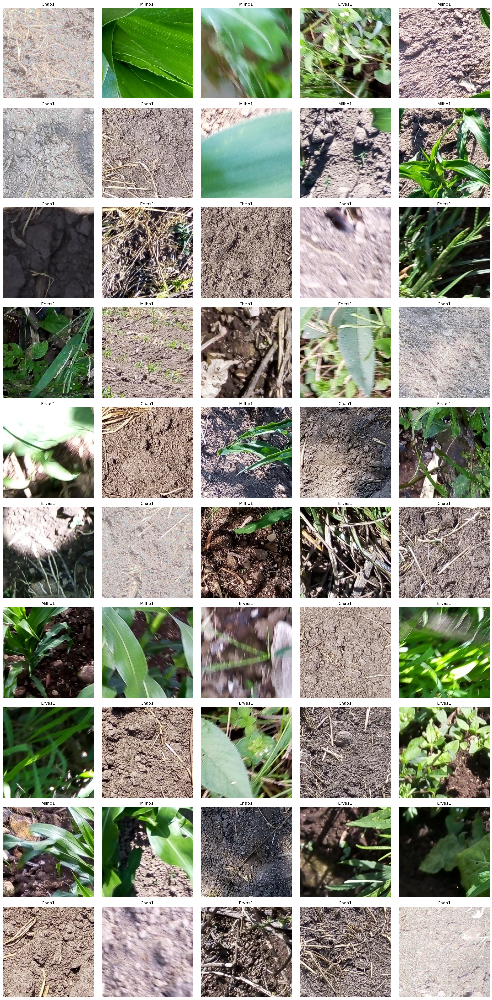

In [7]:
#Afficher les images labéliser
def plot_images_grid(df, num_rows, num_cols):
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 40))
    for i, ax in enumerate(axes.flat):
        img = df.iloc[i]["image"]
        label = df.iloc[i]["label"]
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.set_title(label)
        ax.axis("off")
    plt.tight_layout()
    plt.show()

# Utilisation
plot_images_grid(df_shuffled_validation, 10, 5)

In [ ]:
# Diviser les données de validation pour obtenir un ensemble de validation et un ensemble de test

from sklearn.preprocessing import LabelEncoder


# Convertir les images en tableaux numpy
X_train = np.array(df_shuffled_train["image"].tolist())
X_test = np.array(df_shuffled_test["image"].tolist())
X_val = np.array(df_shuffled_validation["image"].tolist())

# Normaliser les valeurs de pixel des images
X_train = X_train.astype('float32') / 255.0
X_test = X_test.astype('float32') / 255.0
X_val = X_val.astype('float32') / 255.0

# Encoder les étiquettes
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(df_shuffled_train["label"])
y_test = label_encoder.transform(df_shuffled_test["label"])
y_val = label_encoder.transform(df_shuffled_validation["label"])

In [ ]:
from tensorflow.keras.utils import to_categorical
# Convertir les étiquettes encodées en valeurs one-hot
y_train_one_hot = to_categorical(y_train)
y_test_one_hot = to_categorical(y_test)
y_val_one_hot = to_categorical(y_val)

**Modélisation et évaluation des performances des modèles**

## Définir l'architecture du modèle CNN pour optimizers Adam

In [10]:
from tensorflow.keras import layers, models, optimizers

# Définir l'architecture du modèle CNN
def create_cnn_model(optimizer='adam'):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    # Compiler le modèle avec l'optimiseur spécifié
    if optimizer == 'adam':
        opt = optimizers.Adam()
    elif optimizer == 'rmsprop':
        opt = optimizers.RMSprop()
    elif optimizer == 'adagrad':
        opt = optimizers.Adagrad()
    else:
        raise ValueError("Optimizer not supported. Please choose from 'adam', 'rmsprop', or 'adagrad'.")

    model.compile(optimizer=opt,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [11]:
model_adam = create_cnn_model(optimizer='adam')
model_adam.summary()

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    14,745,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,839,363 (56.61 MB)

 Trainable params: 14,839,363 (56.61 MB)

 Non-trainable params: 0 (0.00 B)

In [15]:
# Entraîner le modèle avec l'optimiseur Adam
history_adam = model_adam.fit(X_train, y_train_one_hot, epochs=10, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Évaluer le modèle sur les données de test
test_loss_adam, test_accuracy_adam = model_adam.evaluate(X_test, y_test_one_hot)
print(f"Test Accuracy (Adam): {test_accuracy_adam}")

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 226s 2s/step - accuracy: 0.5984 - loss: 1.3500 - val_accuracy: 0.7764 - val_loss: 0.4891
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 226s 2s/step - accuracy: 0.8389 - loss: 0.4225 - val_accuracy: 0.7545 - val_loss: 0.5700
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 254s 2s/step - accuracy: 0.8767 - loss: 0.3503 - val_accuracy: 0.6886 - val_loss: 0.8201
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 265s 2s/step - accuracy: 0.8661 - loss: 0.3626 - val_accuracy: 0.8623 - val_loss: 0.3897
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 242s 2s/step - accuracy: 0.9255 - loss: 0.2005 - val_accuracy: 0.8882 - val_loss: 0.3518
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 239s 2s/step - accuracy: 0.9372 - loss: 0.1664 - val_accuracy: 0.8124 - val_loss: 0.6884
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 244s 2s/step - accuracy: 0.9569 - loss: 0.1239 - val_accuracy: 0.8603 - val_loss: 0.4796
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 234s 2s/step - accuracy: 0.9682 - loss: 0.0958 - val_accu

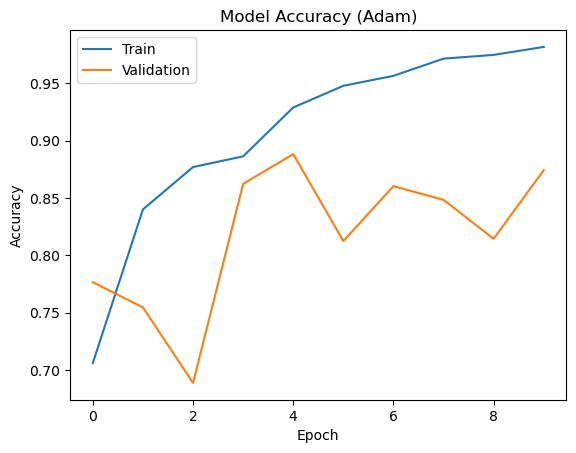

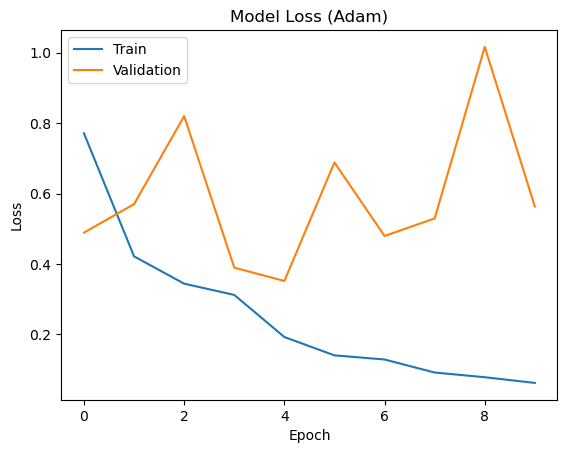

In [16]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values (Adam)
plt.plot(history_adam.history['accuracy'])
plt.plot(history_adam.history['val_accuracy'])
plt.title('Model Accuracy (Adam)')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


# Plot training & validation loss values (Adam)
plt.plot(history_adam.history['loss'])
plt.plot(history_adam.history['val_loss'])
plt.title('Model Loss (Adam)')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 239ms/step


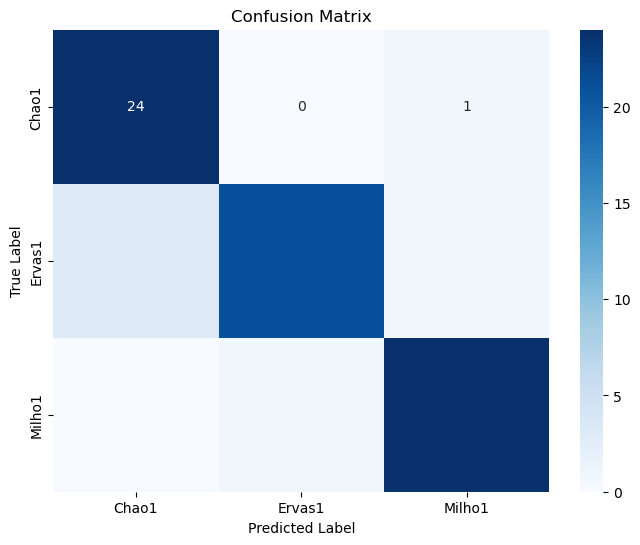

In [22]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test_one_hot):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

# Tracer la matrice de confusion pour le modèle Adam
plot_confusion_matrix(model_adam, X_test, y_test_one_hot)

# Tracer la matrice de confusion pour le modèle RMSprop
#plot_confusion_matrix(model_rmsprop, X_test, y_test)

# Tracer la matrice de confusion pour le modèle Adagrad
#plot_confusion_matrix(model_adagrad, X_test, y_test)

## Définir l'architecture du modèle CNN pour optimizers Adam avec les dropouts

In [7]:
#Pour les dropout = 0,2
from tensorflow.keras.layers import Dropout, BatchNormalization
def create_cnn_model_with_dropout(dropout_rate=0.2):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        BatchNormalization(),  # Ajout de la normalisation par lots
        Dropout(dropout_rate),  # Ajout du dropout avec le taux spécifié
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    model.compile(optimizer='adam',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [26]:
# Créer le modèle avec Dropout (taux de 0.2)
model_dropout_02 = create_cnn_model_with_dropout(dropout_rate=0.2)
history_dropout_02 = model_dropout_02.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))
# Évaluer le modèle sur les données de test
test_loss_adam, test_accuracy_adam = model_adam.evaluate(X_test, y_test)
print(f"Test Accuracy (Adam): {test_accuracy_adam}")

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 231s 2s/step - accuracy: 0.6436 - loss: 0.8096 - val_accuracy: 0.4671 - val_loss: 1.4100
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 225s 2s/step - accuracy: 0.7768 - loss: 0.5703 - val_accuracy: 0.5269 - val_loss: 1.6038
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 219s 2s/step - accuracy: 0.7900 - loss: 0.5219 - val_accuracy: 0.5788 - val_loss: 0.7908
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 200s 1s/step - accuracy: 0.8418 - loss: 0.4173 - val_accuracy: 0.7246 - val_loss: 0.6602
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 210s 1s/step - accuracy: 0.8701 - loss: 0.3543 - val_accuracy: 0.6786 - val_loss: 0.8335
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 217s 2s/step - accuracy: 0.8918 - loss: 0.2970 - val_accuracy: 0.6507 - val_loss: 1.0271
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 223s 2s/step - accuracy: 0.8770 - loss: 0.3148 - val_accuracy: 0.8483 - val_loss: 0.4297
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 218s 2s/step - accuracy: 0.9137 - loss: 0.2296 - val_accu

ValueError: Arguments `target` and `output` must have the same rank (ndim). Received: target.shape=(None,), output.shape=(None, 3)

In [31]:
test_loss_adam, test_accuracy_adam = model_adam.evaluate(X_test, y_test_one_hot)
print(f"Test Accuracy (Adam): {test_accuracy_adam}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 292ms/step - accuracy: 0.9248 - loss: 0.4745
Test Accuracy (Adam): 0.9200000166893005


In [33]:
def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

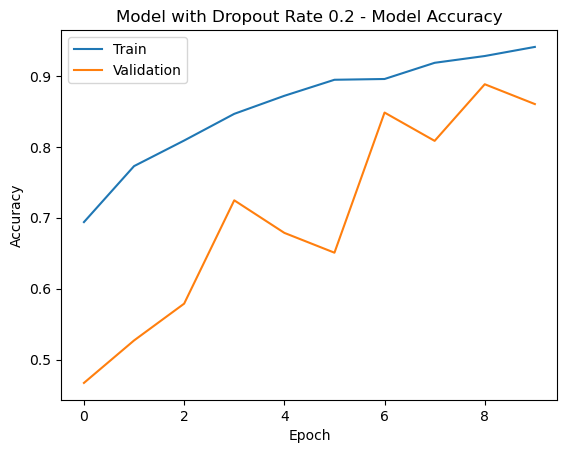

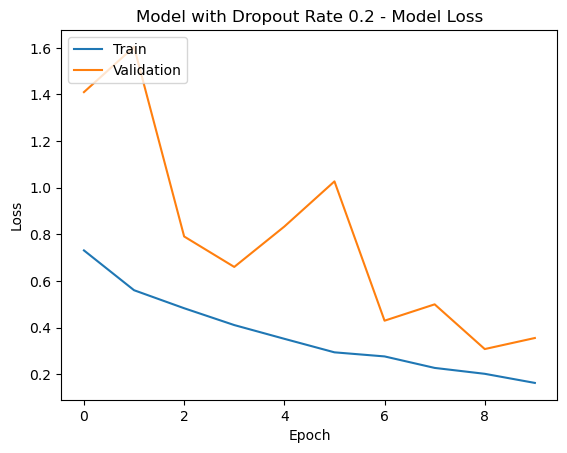

In [34]:
# Plot learning curves for model with Dropout rate 0.2
plot_learning_curves(history_dropout_02, 'Model with Dropout Rate 0.2')

In [35]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 299ms/step


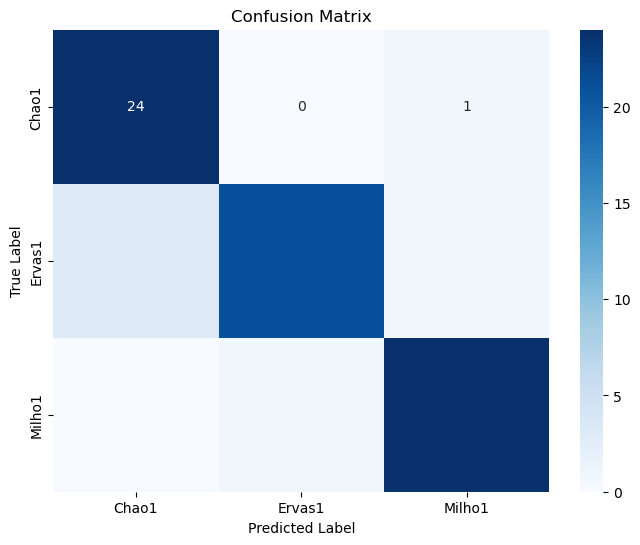

In [36]:
# Tracer la matrice de confusion pour le modèle Adam
plot_confusion_matrix(model_adam, X_test, y_test)

In [ ]:
#Pour les dropout = 0,5

In [8]:
# Créer le modèle avec Dropout (taux de 0.5)
model_dropout_05 = create_cnn_model_with_dropout(dropout_rate=0.5)
history_dropout_05 = model_dropout_05.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))
# Évaluer le modèle sur les données de test


/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 222s 2s/step - accuracy: 0.5813 - loss: 0.9571 - val_accuracy: 0.5090 - val_loss: 1.4778
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 206s 1s/step - accuracy: 0.7385 - loss: 0.6465 - val_accuracy: 0.4311 - val_loss: 3.4949
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 223s 2s/step - accuracy: 0.7631 - loss: 0.5880 - val_accuracy: 0.6128 - val_loss: 0.9435
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 226s 2s/step - accuracy: 0.7874 - loss: 0.5380 - val_accuracy: 0.5729 - val_loss: 1.7838
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 212s 1s/step - accuracy: 0.7890 - loss: 0.5508 - val_accuracy: 0.7585 - val_loss: 0.5596
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 206s 1s/step - accuracy: 0.8414 - loss: 0.4236 - val_accuracy: 0.6747 - val_loss: 0.7288
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 204s 1s/step - accuracy: 0.8661 - loss: 0.3835 - val_accuracy: 0.7046 - val_loss: 0.7507
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 204s 1s/step - accuracy: 0.8708 - loss: 0.3690 - val_accu

NameError: name 'model_adam' is not defined

In [13]:
# Obtenir les prédictions du modèle sur les données de test
y_pred_proba = model_dropout_05.predict(X_test)
# Convertir les probabilités en classes prédites
y_pred = np.argmax(y_pred_proba, axis=1)

# Calculer la perte et l'exactitude manuellement
from sklearn.metrics import accuracy_score, log_loss
test_loss = log_loss(y_test_one_hot, y_pred_proba)
test_accuracy = accuracy_score(np.argmax(y_test_one_hot, axis=1), y_pred)

# Afficher les résultats
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 327ms/step
Test Loss: 0.3536501652597245
Test Accuracy: 0.8666666666666667


In [14]:
import matplotlib.pyplot as plt

def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

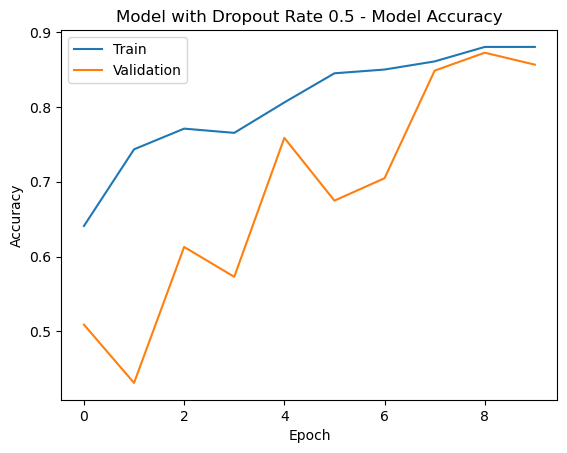

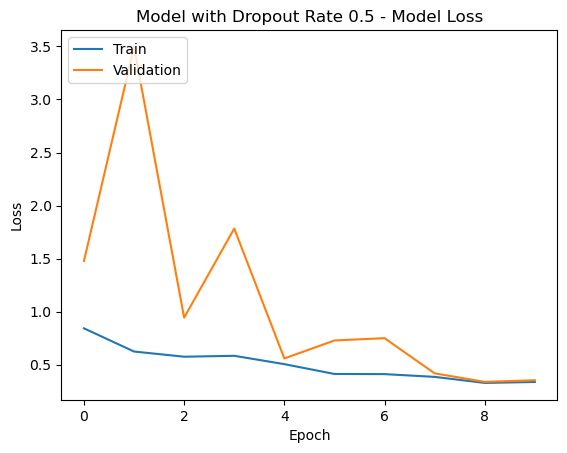

In [15]:
# Plot learning curves for model with Dropout rate 0.5
plot_learning_curves(history_dropout_05, 'Model with Dropout Rate 0.5')

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 289ms/step


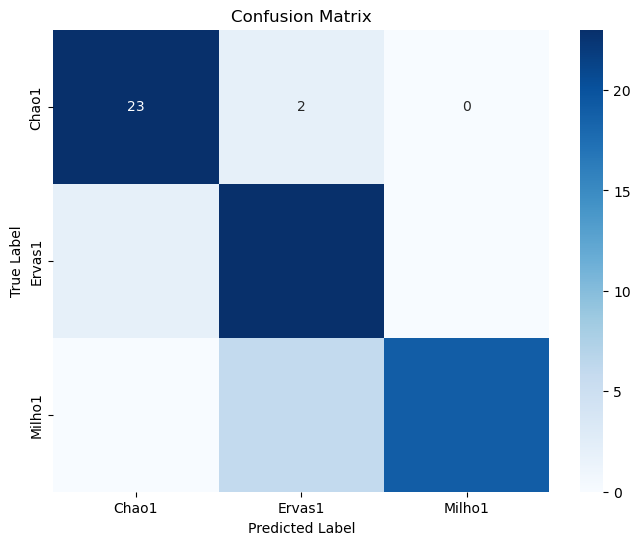

In [19]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()



# Utiliser le modèle pour faire des prédictions sur les données de test
y_pred = np.argmax(model_dropout_05.predict(X_test), axis=-1)

# Tracer la matrice de confusion pour le modèle dropout_05
plot_confusion_matrix(model_dropout_05, X_test, y_test)


##Utilisation des modèles préentraînés pour ADAM : VGG16, VGG19, Xception

In [ ]:
#Pour le modele VGG16

from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 573s 4s/step - accuracy: 0.6314 - loss: 1.3789 - val_accuracy: 0.8204 - val_loss: 0.4524
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 603s 4s/step - accuracy: 0.7977 - loss: 0.4925 - val_accuracy: 0.8363 - val_loss: 0.3846
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 598s 4s/step - accuracy: 0.8160 - loss: 0.4477 - val_accuracy: 0.8144 - val_loss: 0.4081
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 563s 4s/step - accuracy: 0.8445 - loss: 0.3907 - val_accuracy: 0.8463 - val_loss: 0.3897
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 575s 4s/step - accuracy: 0.8311 - loss: 0.3839 - val_accuracy: 0.8583 - val_loss: 0.3918
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 582s 4s/step - accuracy: 0.8459 - loss: 0.3572 - val_accuracy: 0.8563 - val_loss: 0.3581
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 589s 4s/step - accuracy: 0.8579 - loss: 0.3107 - val_accuracy: 0.8703 - val_loss: 0.3378
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 597s 4s/step - accuracy: 0.8693 - loss: 0.2775 - val_accu

In [21]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.8564 - loss: 0.3544
Accuracy on test data: 0.8533333539962769


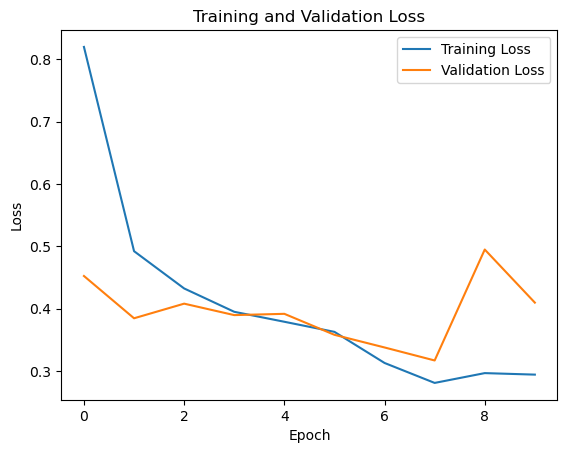

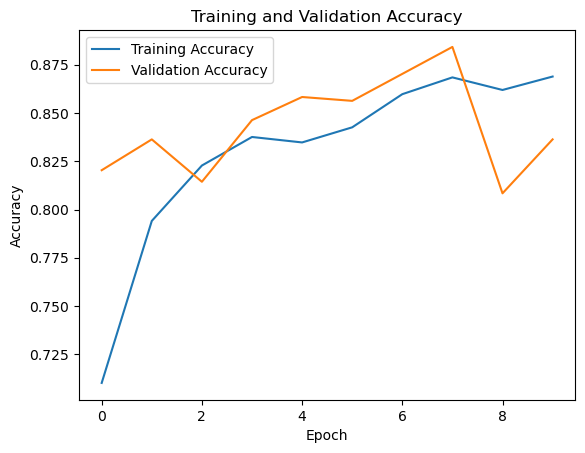

In [22]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 3s/step


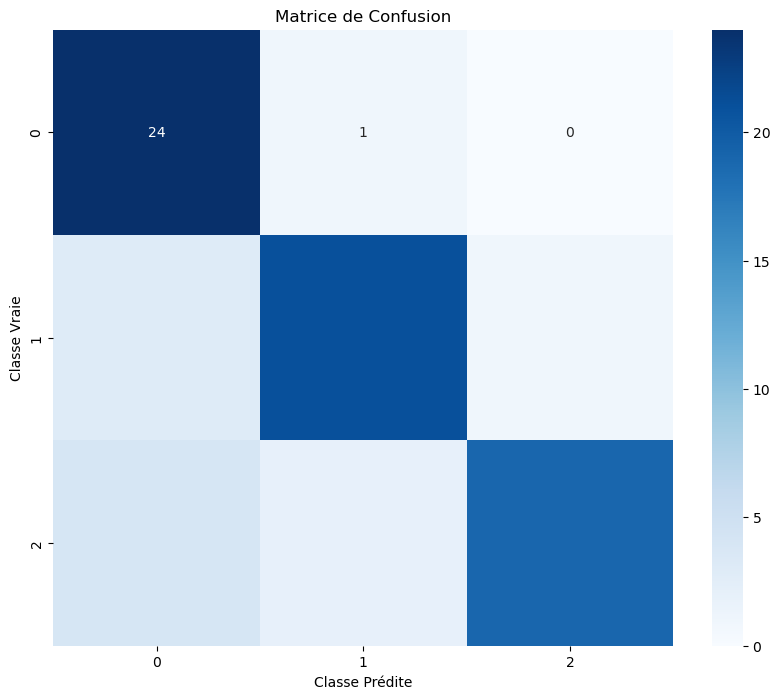

In [23]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()

les images et la probabilité correspondant à la classe que le modèle a identifié
comme le plus probable

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


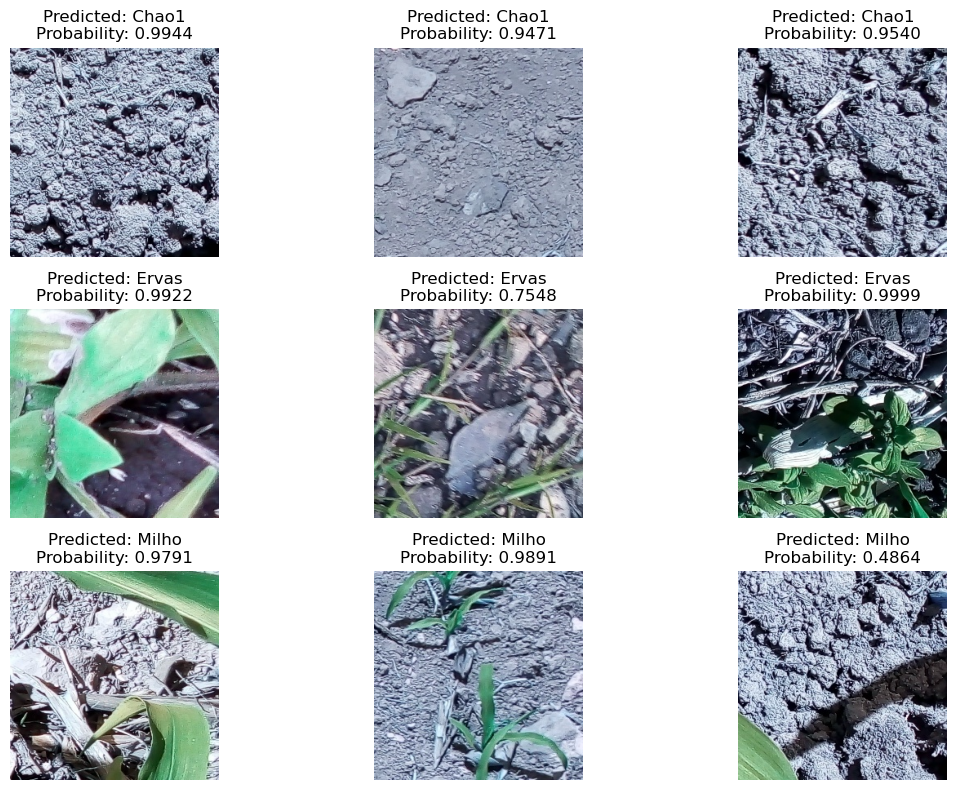

In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

les superpixels explicatifs

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 

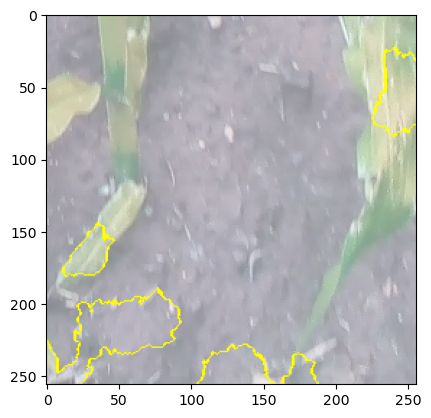

In [25]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()


In [ ]:
## Définir l'architecture du modèle CNN pour optimizers Adam et utilisation du modele VGG19

In [26]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=6, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 743s 5s/step - accuracy: 0.5791 - loss: 1.6858 - val_accuracy: 0.8164 - val_loss: 0.5632
Epoch 2/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 736s 5s/step - accuracy: 0.7064 - loss: 0.6187 - val_accuracy: 0.8463 - val_loss: 0.4259
Epoch 3/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 740s 5s/step - accuracy: 0.7393 - loss: 0.5439 - val_accuracy: 0.8164 - val_loss: 0.4640
Epoch 4/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 744s 5s/step - accuracy: 0.7724 - loss: 0.4831 - val_accuracy: 0.8283 - val_loss: 0.4227
Epoch 5/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 750s 5s/step - accuracy: 0.7862 - loss: 0.4543 - val_accuracy: 0.8383 - val_loss: 0.4079
Epoch 6/6
144/144 ━━━━━━━━━━━━━━━━━━━━ 754s 5s/step - accuracy: 0.7935 - loss: 0.4187 - val_accuracy: 0.7405 - val_loss: 0.5528


In [27]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 10s 3s/step - accuracy: 0.8023 - loss: 0.4104
Accuracy on test data: 0.800000011920929


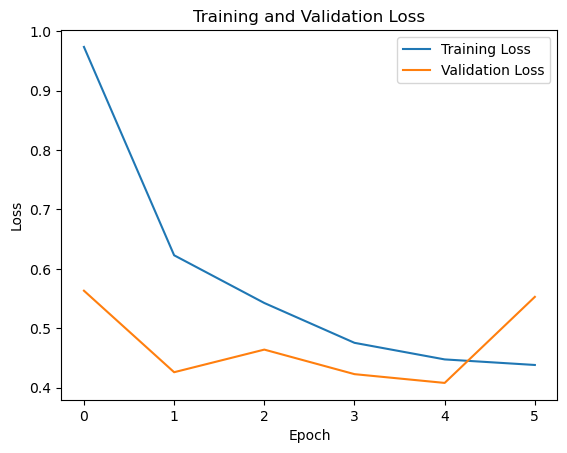

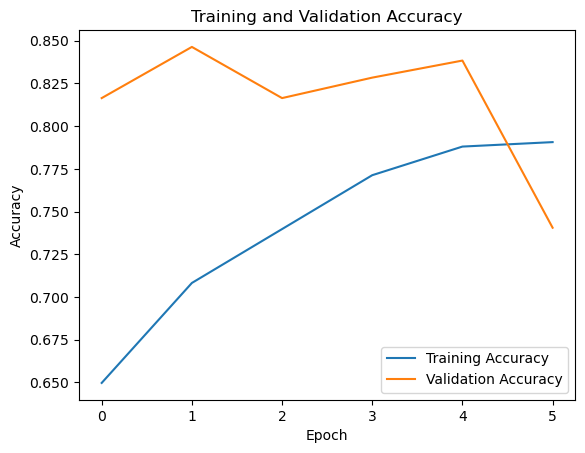

In [28]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


3/3 ━━━━━━━━━━━━━━━━━━━━ 11s 3s/step


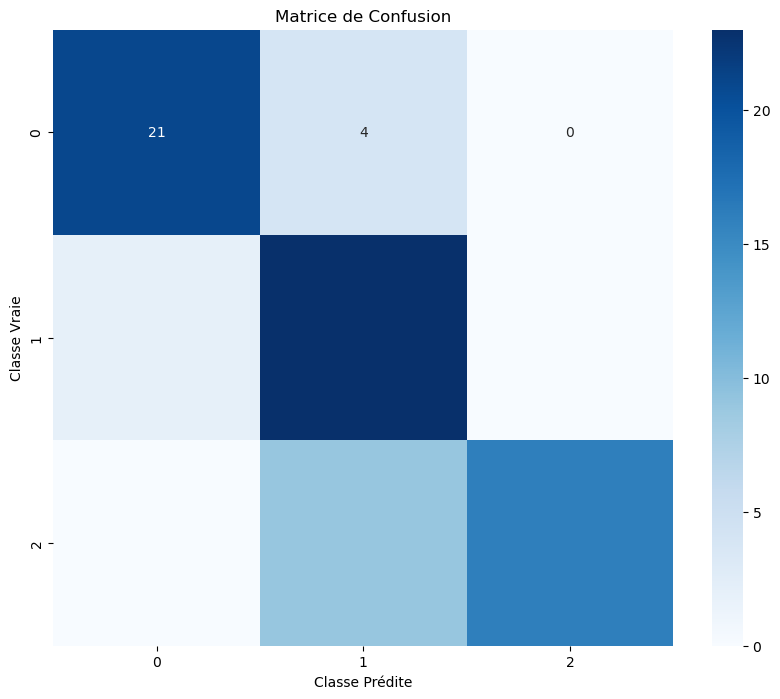

In [29]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


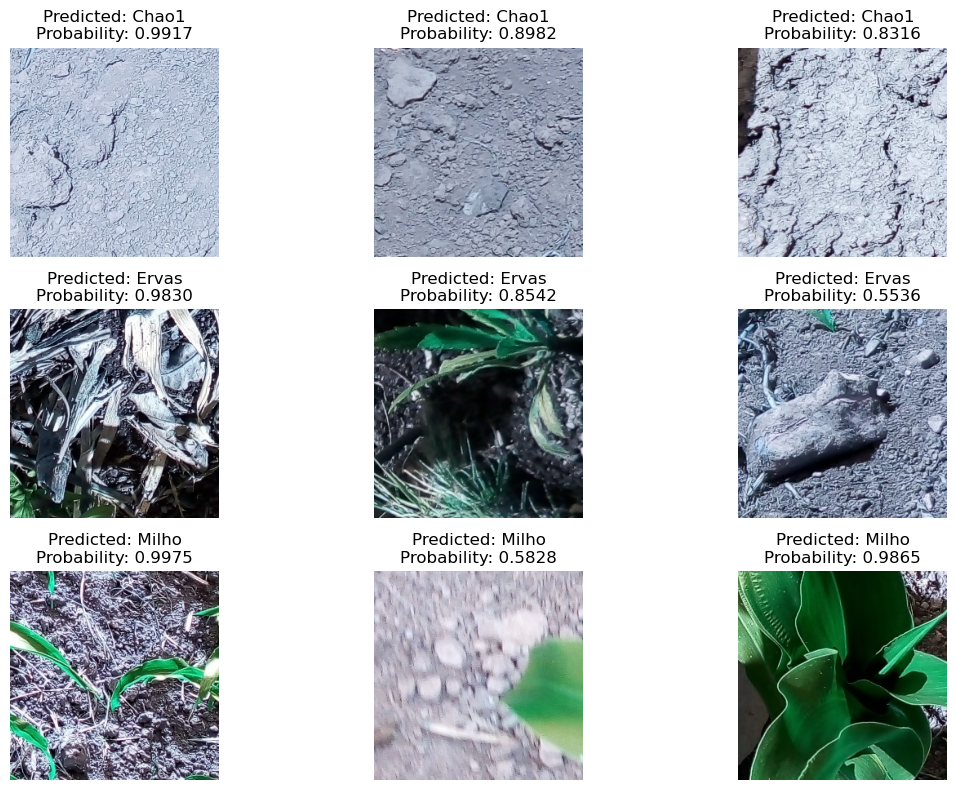

In [30]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 

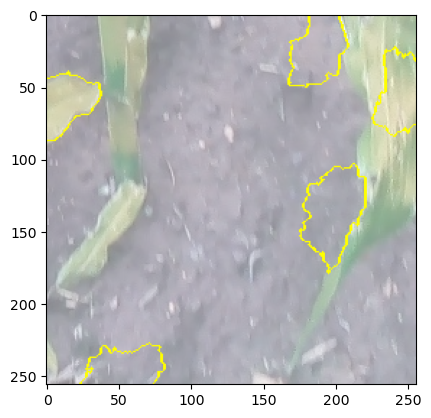

In [31]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()

In [ ]:
## Définir l'architecture du modèle CNN pour optimizers Adam et utilisation du modele Xception

In [32]:
from tensorflow.keras.applications import Xception  # Importer Xception
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Charger le modèle Xception pré-entraîné (poids ImageNet)
base_model = Xception(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle Xception
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à votre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur RMSprop et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec vos données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 465s 3s/step - accuracy: 0.7195 - loss: 2.2829 - val_accuracy: 0.8383 - val_loss: 0.3783
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 468s 3s/step - accuracy: 0.8294 - loss: 0.4309 - val_accuracy: 0.8563 - val_loss: 0.3949
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 491s 3s/step - accuracy: 0.8451 - loss: 0.3825 - val_accuracy: 0.8862 - val_loss: 0.3389
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 490s 3s/step - accuracy: 0.8692 - loss: 0.3325 - val_accuracy: 0.8603 - val_loss: 0.3708
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 477s 3s/step - accuracy: 0.8741 - loss: 0.3109 - val_accuracy: 0.8643 - val_loss: 0.3691
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 473s 3s/step - accuracy: 0.8987 - loss: 0.2439 - val_accuracy: 0.8822 - val_loss: 0.3359
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 494s 3s/step - accuracy: 0.8930 - loss: 0.2490 - val_accuracy: 0.8743 - val_loss: 0.3442
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 497s 3s/step - accuracy: 0.9079 - loss: 0.2404 - val_accu

In [33]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.9237 - loss: 0.4717
Accuracy on test data: 0.9333333373069763


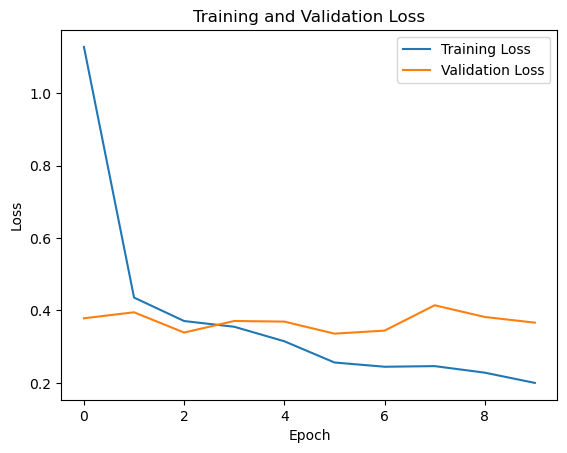

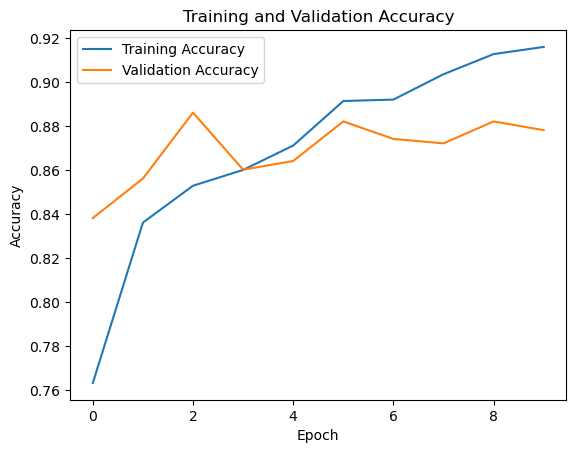

In [34]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step


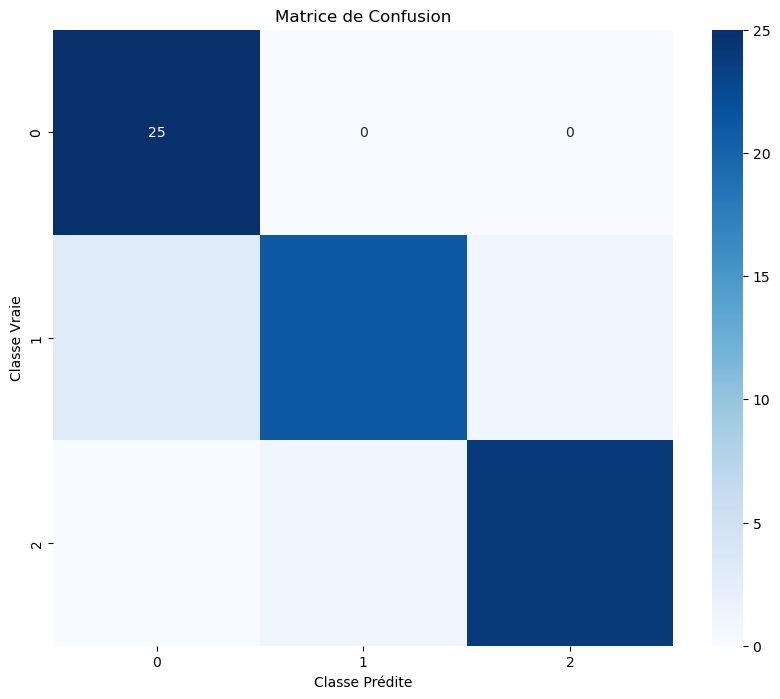

In [35]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


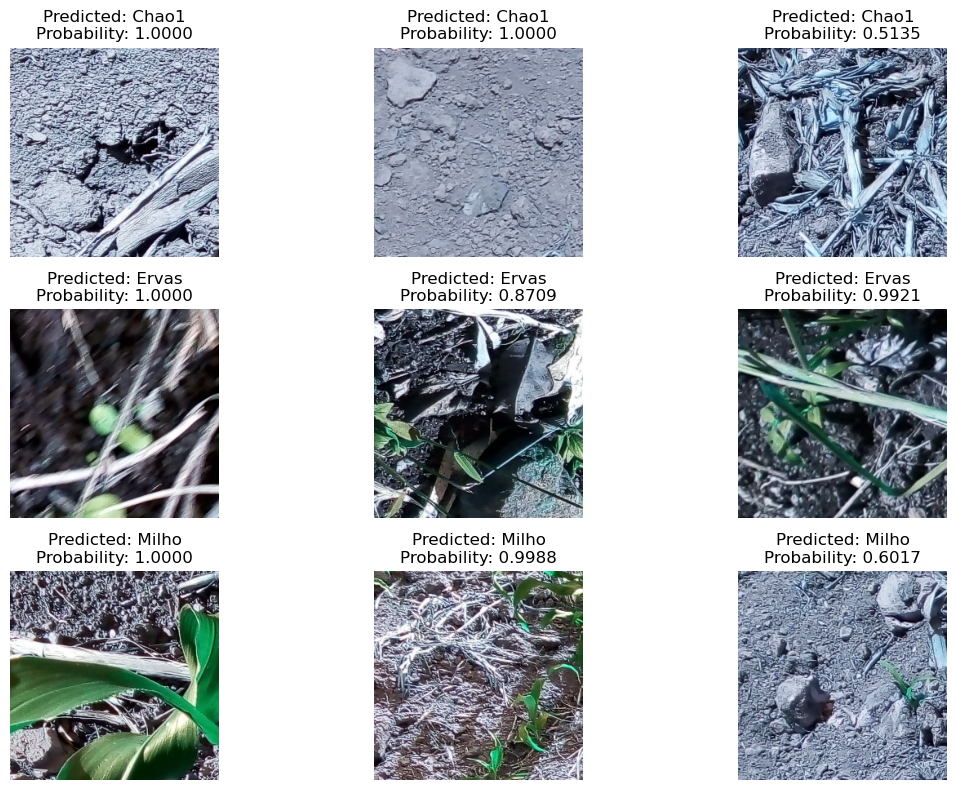

In [36]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 772ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 780ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 761ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 831ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 800ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 784ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 783ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 768ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 800ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 787ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 785ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 822ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 793ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 823ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 788ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 822ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 808ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 816ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 844ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 816ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

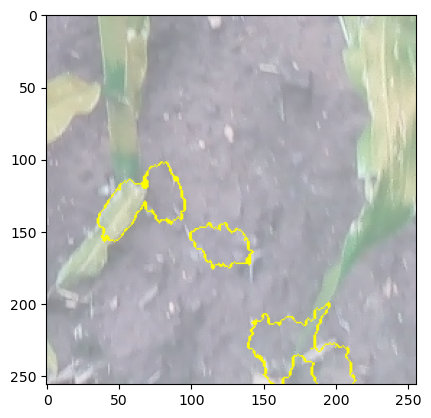

In [37]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()


## Définir l'architecture du modèle CNN pour optimizers RMSprop

In [ ]:
###############################################optimiseur RMSprop#############################@@#####################################

In [38]:
# Définir l'architecture du modèle CNN
def create_cnn_model(optimizer='rmsprop'):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    # Compiler le modèle avec l'optimiseur spécifié
    if optimizer == 'adam':
        opt = optimizers.Adam()
    elif optimizer == 'rmsprop':
        opt = optimizers.RMSprop()
    elif optimizer == 'adagrad':
        opt = optimizers.Adagrad()
    else:
        raise ValueError("Optimizer not supported. Please choose from 'adam', 'rmsprop', or 'adagrad'.")

    model.compile(optimizer=opt,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [39]:
#Créer le modèle avec l'optimiseur RMSprop
model_rmsprop = create_cnn_model(optimizer='rmsprop')

# Afficher un résumé du modèle avec l'optimiseur RMSprop
model_rmsprop.summary()

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_7 (Conv2D)               │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 128)            │    14,745,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,839,363 (56.61 MB)

 Trainable params: 14,839,363 (56.61 MB)

 Non-trainable params: 0 (0.00 B)

In [40]:
# Entraîner le modèle avec l'optimiseur RMSprop
history_rmsprop = model_rmsprop.fit(X_train, y_train_one_hot, epochs=10, batch_size=32, validation_data=(X_val, y_val_one_hot))


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 227s 2s/step - accuracy: 0.4983 - loss: 2.1100 - val_accuracy: 0.7505 - val_loss: 0.5958
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 221s 2s/step - accuracy: 0.7471 - loss: 0.6147 - val_accuracy: 0.7904 - val_loss: 0.5352
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 219s 2s/step - accuracy: 0.8064 - loss: 0.5127 - val_accuracy: 0.8184 - val_loss: 0.4321
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 218s 2s/step - accuracy: 0.8295 - loss: 0.4322 - val_accuracy: 0.7106 - val_loss: 0.7869
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 222s 2s/step - accuracy: 0.8568 - loss: 0.3651 - val_accuracy: 0.8743 - val_loss: 0.3469
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 201s 1s/step - accuracy: 0.8803 - loss: 0.3119 - val_accuracy: 0.8024 - val_loss: 0.5310
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 205s 1s/step - accuracy: 0.9130 - loss: 0.2488 - val_accuracy: 0.8124 - val_loss: 0.5379
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 201s 1s/step - accuracy: 0.9424 - loss: 0.1823 - val_accu

In [41]:

# Évaluer le modèle sur les données de test
test_loss_rmsprop, test_accuracy_rmsprop = model_rmsprop.evaluate(X_test, y_test_one_hot)
print(f"Test Accuracy (RMSprop): {test_accuracy_rmsprop}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 241ms/step - accuracy: 0.8658 - loss: 0.4719
Test Accuracy (RMSprop): 0.8799999952316284


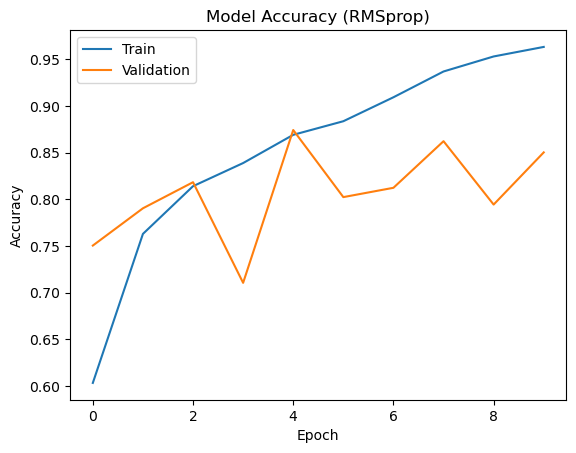

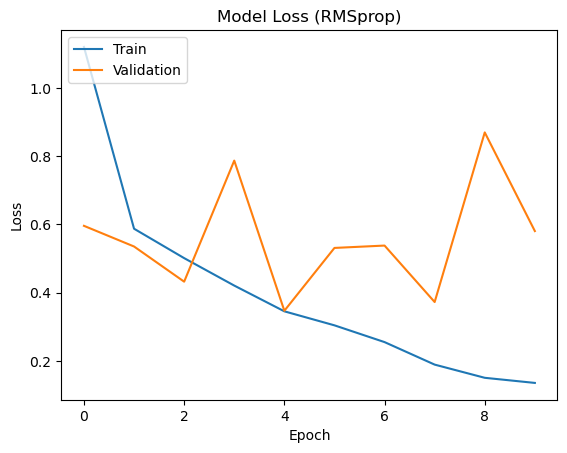

In [42]:
# Plot training & validation accuracy values (RMSprop)
plt.plot(history_rmsprop.history['accuracy'])
plt.plot(history_rmsprop.history['val_accuracy'])
plt.title('Model Accuracy (RMSprop)')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values (RMSprop)
plt.plot(history_rmsprop.history['loss'])
plt.plot(history_rmsprop.history['val_loss'])
plt.title('Model Loss (RMSprop)')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [43]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 245ms/step


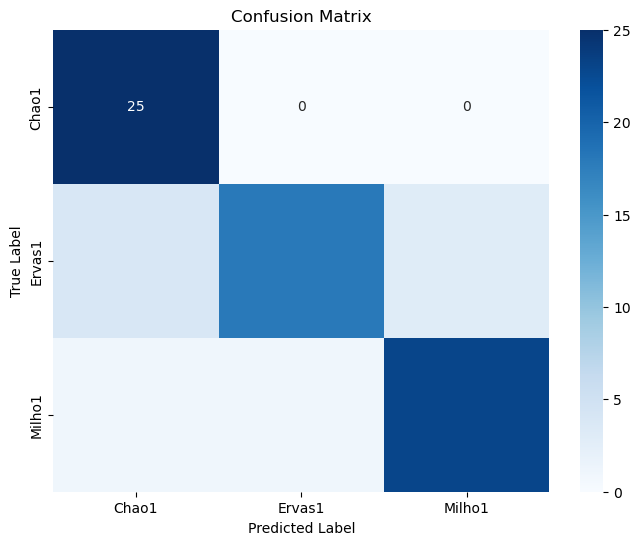

In [45]:
# Tracer la matrice de confusion pour le modèle RMSprop

plot_confusion_matrix(model_rmsprop, X_test, y_test)

In [46]:
from tensorflow.keras.layers import Dropout, BatchNormalization

def create_cnn_model_with_dropout(dropout_rate=0.2):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        BatchNormalization(),  # Ajout de la normalisation par lots
        Dropout(dropout_rate),  # Ajout du dropout avec le taux spécifié
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    model.compile(optimizer='RMSprop',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [48]:
# Créer le modèle avec Dropout (taux de 0.2)
model_dropout_02 = create_cnn_model_with_dropout(dropout_rate=0.2)
history_dropout_02 = model_dropout_02.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 211s 1s/step - accuracy: 0.6436 - loss: 0.8380 - val_accuracy: 0.3453 - val_loss: 7.2577
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 200s 1s/step - accuracy: 0.7580 - loss: 0.6166 - val_accuracy: 0.4830 - val_loss: 1.4305
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 197s 1s/step - accuracy: 0.7823 - loss: 0.5333 - val_accuracy: 0.5150 - val_loss: 1.5108
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 198s 1s/step - accuracy: 0.8041 - loss: 0.4703 - val_accuracy: 0.6766 - val_loss: 0.6693
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 209s 1s/step - accuracy: 0.8441 - loss: 0.4087 - val_accuracy: 0.7525 - val_loss: 0.6222
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.8693 - loss: 0.3354 - val_accuracy: 0.8204 - val_loss: 0.4688
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 192s 1s/step - accuracy: 0.8869 - loss: 0.2910 - val_accuracy: 0.8483 - val_loss: 0.3699
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 217s 2s/step - accuracy: 0.8991 - loss: 0.2593 - val_accu

In [49]:
#Évaluer le modèle sur les données de test
test_loss_rmsprop, test_accuracy_rmsprop = model_rmsprop.evaluate(X_test, y_test_one_hot)
print(f"Test Accuracy (RMSprop): {test_accuracy_rmsprop}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 283ms/step - accuracy: 0.8658 - loss: 0.4719
Test Accuracy (RMSprop): 0.8799999952316284


In [50]:
import matplotlib.pyplot as plt

def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

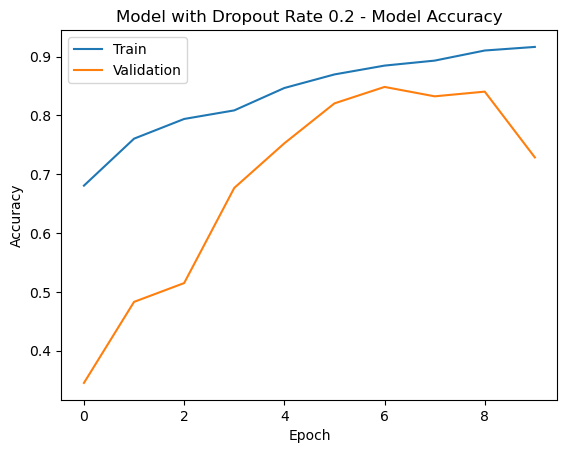

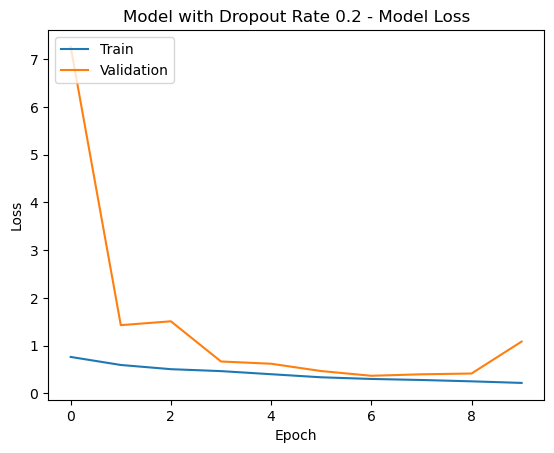

In [51]:

# Plot learning curves for model with Dropout rate 0.2
plot_learning_curves(history_dropout_02, 'Model with Dropout Rate 0.2')

In [52]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 254ms/step


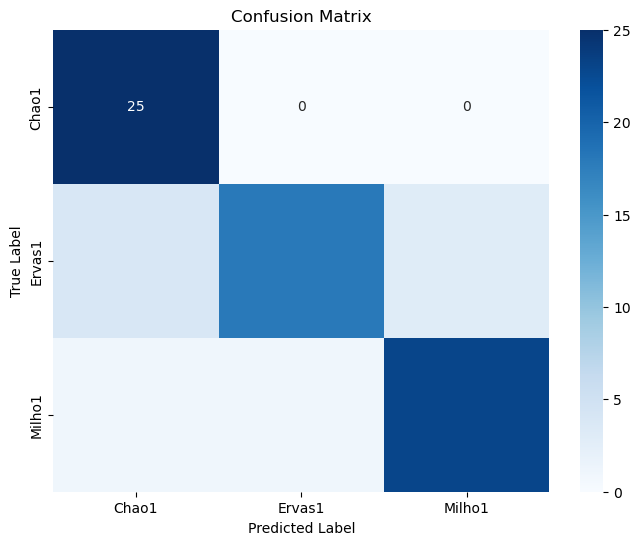

In [53]:
# Tracer la matrice de confusion pour le modèle RMSprop
plot_confusion_matrix(model_rmsprop, X_test, y_test)

In [54]:
# Créer le modèle avec Dropout (taux de 0.5)
model_dropout_05 = create_cnn_model_with_dropout(dropout_rate=0.5)
history_dropout_05 = model_dropout_05.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 216s 1s/step - accuracy: 0.5691 - loss: 1.0076 - val_accuracy: 0.7305 - val_loss: 0.7041
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 208s 1s/step - accuracy: 0.7444 - loss: 0.6389 - val_accuracy: 0.4251 - val_loss: 1.6135
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 199s 1s/step - accuracy: 0.7727 - loss: 0.5725 - val_accuracy: 0.4331 - val_loss: 3.9208
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 207s 1s/step - accuracy: 0.7682 - loss: 0.5735 - val_accuracy: 0.6806 - val_loss: 0.7421
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 200s 1s/step - accuracy: 0.8039 - loss: 0.4834 - val_accuracy: 0.5749 - val_loss: 0.7885
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 199s 1s/step - accuracy: 0.8306 - loss: 0.4334 - val_accuracy: 0.6168 - val_loss: 0.9031
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 199s 1s/step - accuracy: 0.8414 - loss: 0.4023 - val_accuracy: 0.8723 - val_loss: 0.3242
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 213s 1s/step - accuracy: 0.8627 - loss: 0.3687 - val_accu

In [57]:
#Évaluer le modèle sur les données de test
test_loss_rmsprop, test_accuracy_rmsprop = model_dropout_05.evaluate(X_test, y_test)
print(f"Test Accuracy (RMSprop): {test_accuracy_rmsprop}")


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 278ms/step - accuracy: 0.6493 - loss: 0.7503
Test Accuracy (RMSprop): 0.6266666650772095


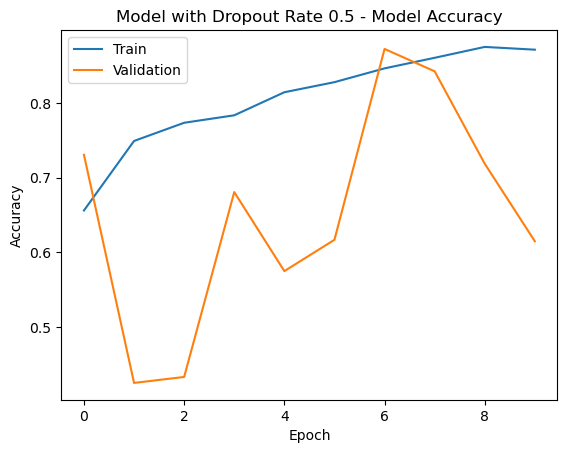

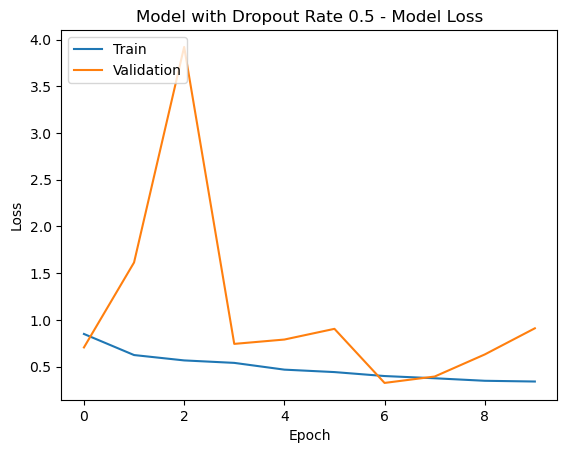

In [58]:
import matplotlib.pyplot as plt

def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

# Plot learning curves for model with Dropout rate 0.5
plot_learning_curves(history_dropout_05, 'Model with Dropout Rate 0.5')

In [59]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 319ms/step


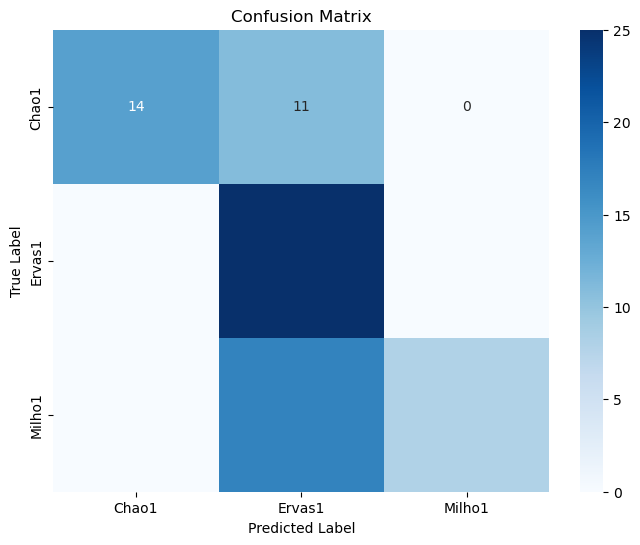

In [61]:
# Tracer la matrice de confusion pour le modèle RMSprop
plot_confusion_matrix(model_dropout_05, X_test, y_test)

In [62]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import RMSprop

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=RMSprop(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 581s 4s/step - accuracy: 0.5909 - loss: 2.7606 - val_accuracy: 0.8024 - val_loss: 0.4675
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 593s 4s/step - accuracy: 0.7618 - loss: 0.5998 - val_accuracy: 0.7844 - val_loss: 0.5132
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 597s 4s/step - accuracy: 0.7877 - loss: 0.5247 - val_accuracy: 0.7505 - val_loss: 0.5827
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 612s 4s/step - accuracy: 0.8271 - loss: 0.4481 - val_accuracy: 0.8623 - val_loss: 0.3982
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 587s 4s/step - accuracy: 0.8516 - loss: 0.3860 - val_accuracy: 0.8323 - val_loss: 0.4001
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 581s 4s/step - accuracy: 0.8500 - loss: 0.3884 - val_accuracy: 0.8204 - val_loss: 0.4605
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 563s 4s/step - accuracy: 0.8649 - loss: 0.3390 - val_accuracy: 0.8523 - val_loss: 0.3903
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 594s 4s/step - accuracy: 0.8686 - loss: 0.3170 - val_accu

In [63]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.8669 - loss: 0.4435
Accuracy on test data: 0.8666666746139526


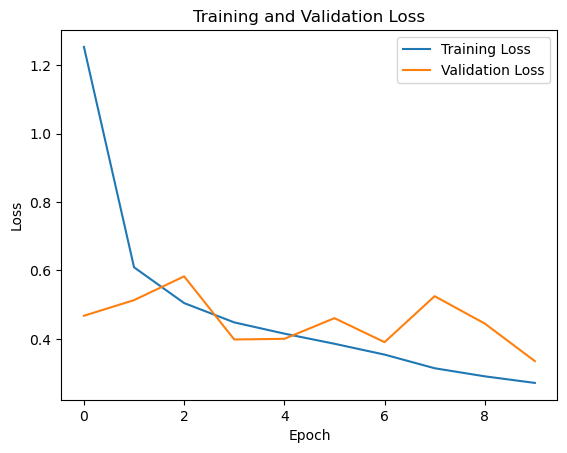

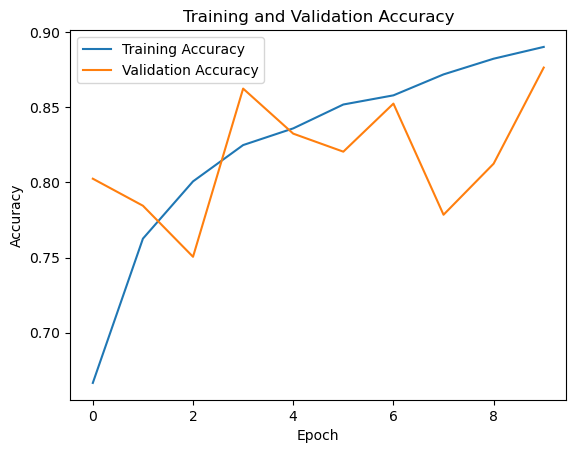

In [64]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

2/3 ━━━━━━━━━━━━━━━━━━━━ 3s 4s/stepWARNING:tensorflow:5 out of the last 13 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x178689800> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 3s/step


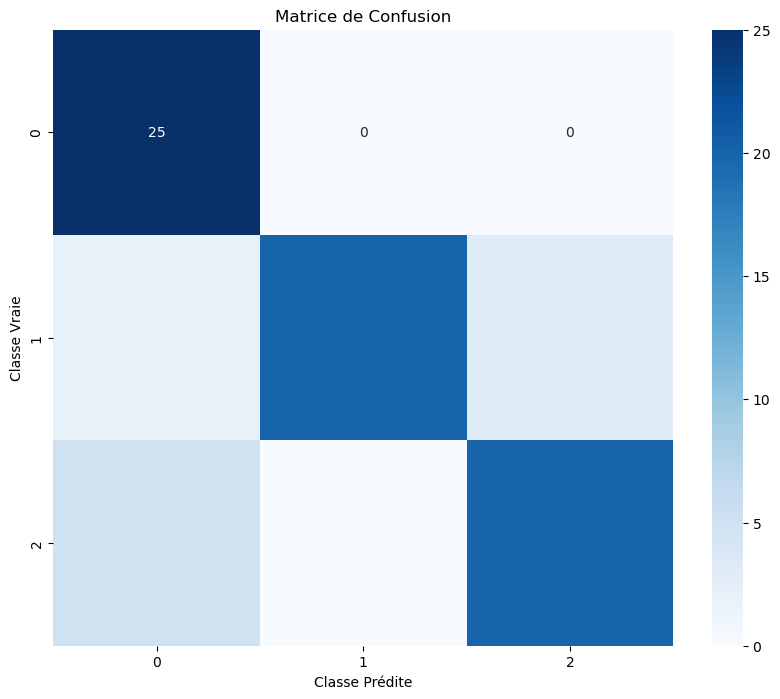

In [65]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


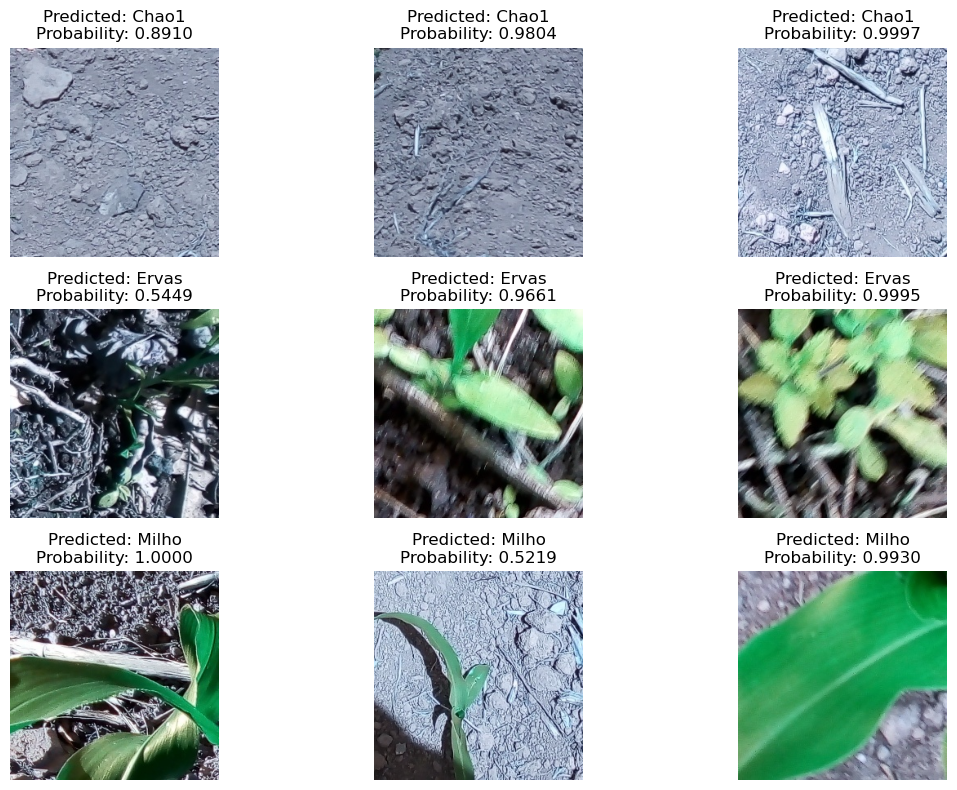

In [66]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 

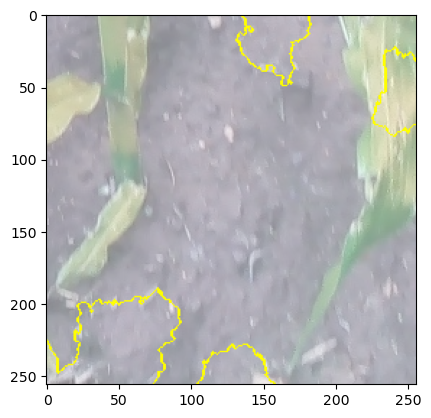

In [67]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()


In [68]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import RMSprop

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG19
for layer in base_model.layers:
    layer.trainable = False



# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=RMSprop(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 748s 5s/step - accuracy: 0.5605 - loss: 2.5256 - val_accuracy: 0.7665 - val_loss: 0.5808
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 765s 5s/step - accuracy: 0.7209 - loss: 0.6560 - val_accuracy: 0.7864 - val_loss: 0.5388
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 732s 5s/step - accuracy: 0.7556 - loss: 0.5709 - val_accuracy: 0.8104 - val_loss: 0.4570
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 742s 5s/step - accuracy: 0.7766 - loss: 0.5465 - val_accuracy: 0.8483 - val_loss: 0.4397
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 739s 5s/step - accuracy: 0.8071 - loss: 0.4635 - val_accuracy: 0.7884 - val_loss: 0.5010
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 777s 5s/step - accuracy: 0.8138 - loss: 0.4468 - val_accuracy: 0.8224 - val_loss: 0.4908
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 730s 5s/step - accuracy: 0.8326 - loss: 0.4145 - val_accuracy: 0.8363 - val_loss: 0.4634
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 766s 5s/step - accuracy: 0.8324 - loss: 0.4075 - val_accu

In [69]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 11s 3s/step - accuracy: 0.8630 - loss: 0.3947
Accuracy on test data: 0.8666666746139526


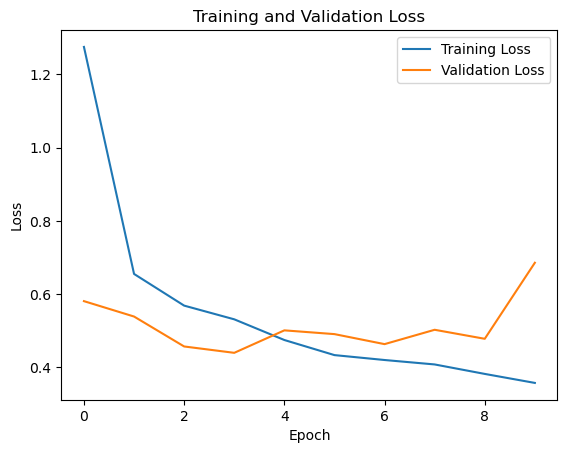

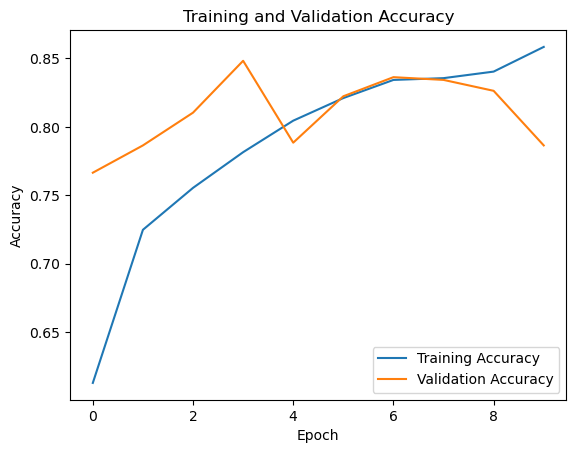

In [74]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 12s 3s/step


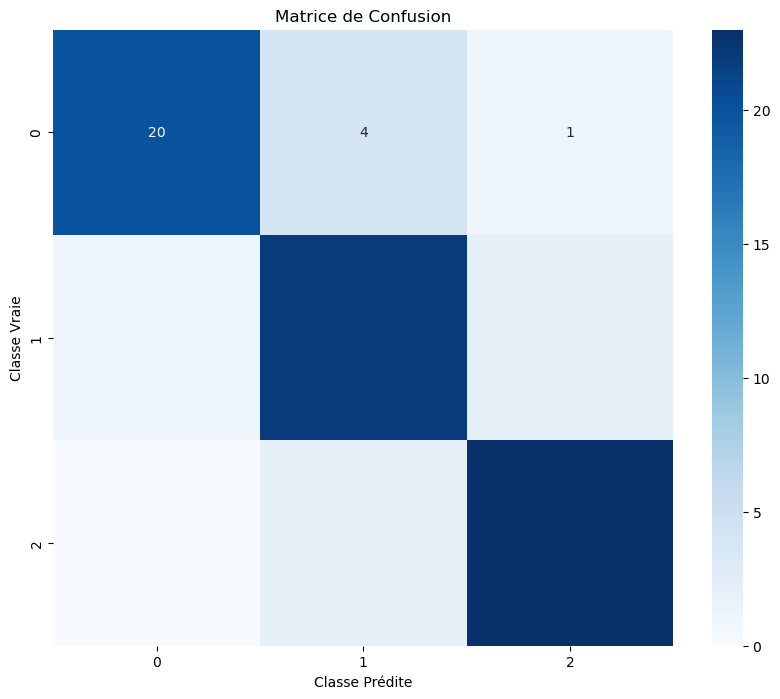

In [71]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


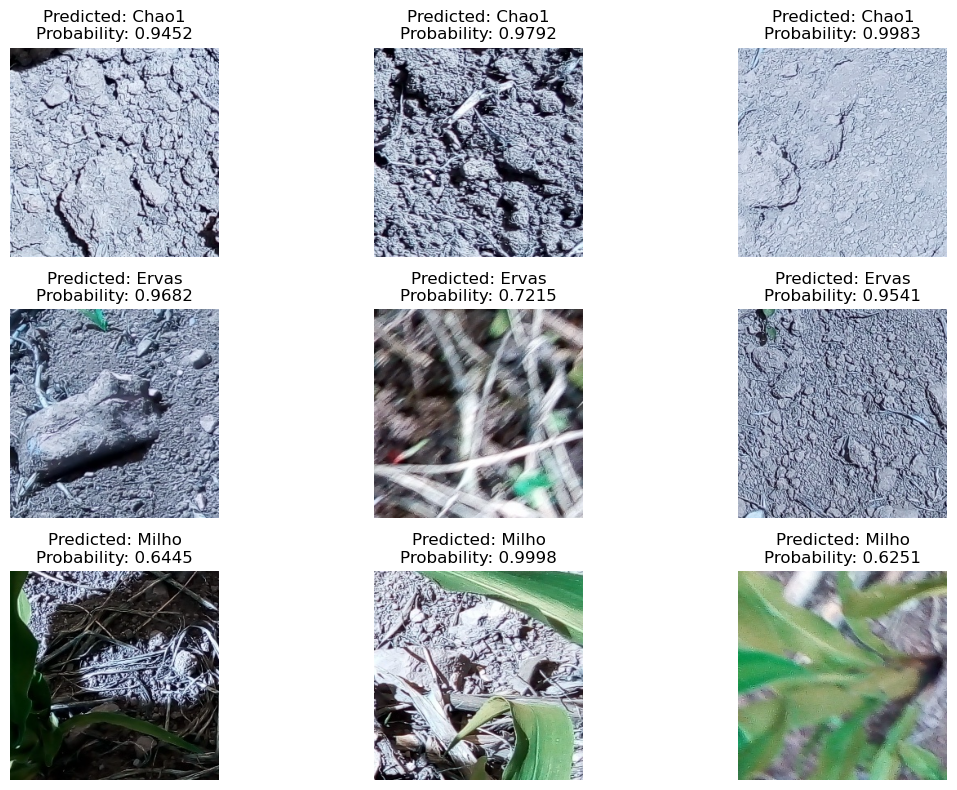

In [72]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 

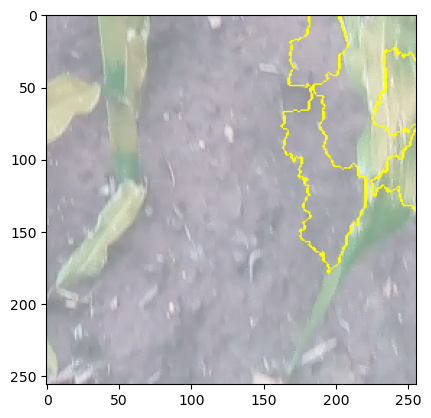

In [73]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()

In [75]:
from tensorflow.keras.applications import Xception
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import RMSprop

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = Xception(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=RMSprop(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 448s 3s/step - accuracy: 0.7047 - loss: 5.2930 - val_accuracy: 0.8663 - val_loss: 0.4656
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 462s 3s/step - accuracy: 0.8336 - loss: 0.5572 - val_accuracy: 0.8463 - val_loss: 0.6635
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 448s 3s/step - accuracy: 0.8798 - loss: 0.3926 - val_accuracy: 0.8862 - val_loss: 0.3906
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 442s 3s/step - accuracy: 0.8802 - loss: 0.3726 - val_accuracy: 0.8703 - val_loss: 0.5051
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 500s 3s/step - accuracy: 0.9010 - loss: 0.3107 - val_accuracy: 0.8782 - val_loss: 0.4260
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 492s 3s/step - accuracy: 0.9116 - loss: 0.3072 - val_accuracy: 0.8942 - val_loss: 0.4457
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 481s 3s/step - accuracy: 0.9151 - loss: 0.2513 - val_accuracy: 0.8862 - val_loss: 0.6073
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 458s 3s/step - accuracy: 0.9253 - loss: 0.2286 - val_accu

In [76]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9170 - loss: 0.7853
Accuracy on test data: 0.9200000166893005


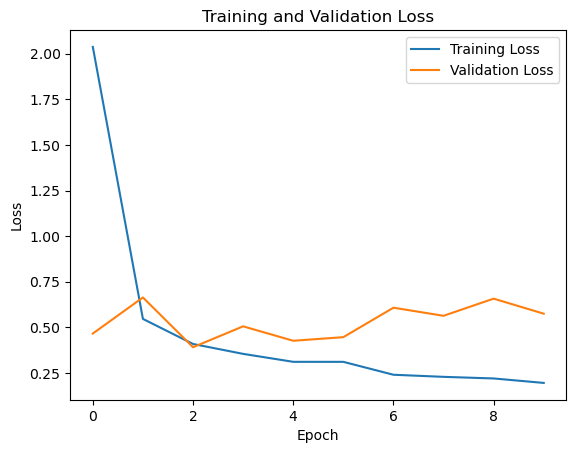

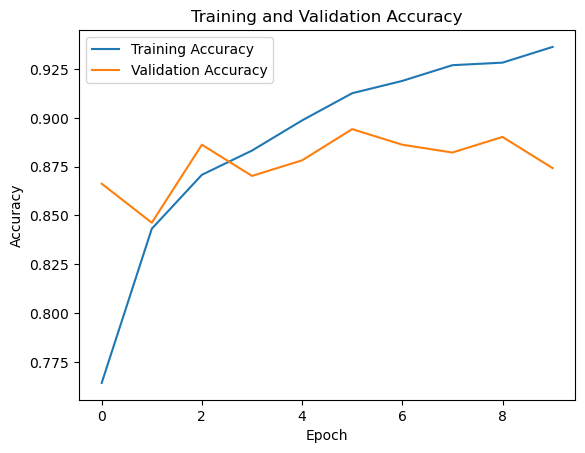

In [77]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step


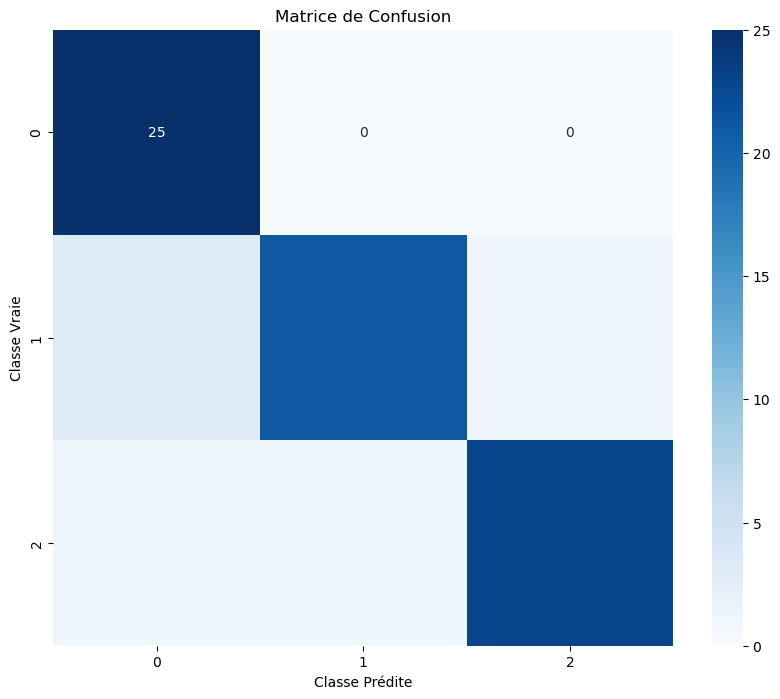

In [78]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


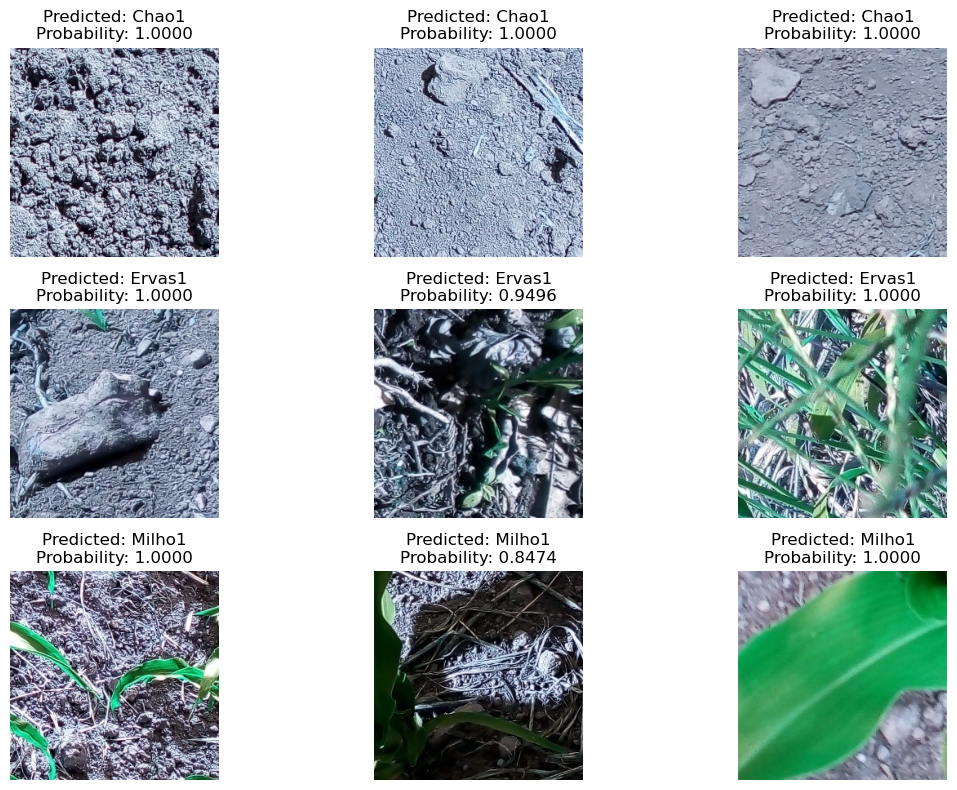

In [80]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas1", "Milho1"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 791ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 837ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 851ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 795ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 782ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 737ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

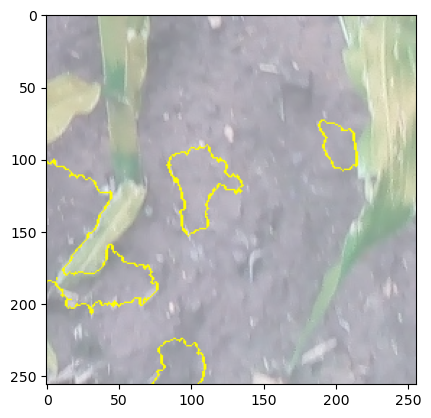

In [81]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()

## Définir l'architecture du modèle CNN pour optimizers adagrad

In [ ]:
#############################################################################################adagrad######################################################################################################

In [7]:
# Définir l'architecture du modèle CNN
def create_cnn_model(optimizer='adagrad'):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    # Compiler le modèle avec l'optimiseur spécifié
    if optimizer == 'adam':
        opt = optimizers.Adam()
    elif optimizer == 'rmsprop':
        opt = optimizers.RMSprop()
    elif optimizer == 'adagrad':
        opt = optimizers.Adagrad()
    else:
        raise ValueError("Optimizer not supported. Please choose from 'adam', 'rmsprop', or 'adagrad'.")

    model.compile(optimizer=opt,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model
# Créer le modèle avec l'optimiseur Adagrad
model_adagrad = create_cnn_model(optimizer='adagrad')

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


In [8]:
# Afficher un résumé du modèle avec l'optimiseur Adagrad
model_adagrad.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    14,745,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,839,363 (56.61 MB)

 Trainable params: 14,839,363 (56.61 MB)

 Non-trainable params: 0 (0.00 B)

In [9]:
# Entraîner le modèle avec l'optimiseur Adagrad
history_adagrad = model_adagrad.fit(X_train, y_train_one_hot, epochs=10, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Évaluer le modèle sur les données de test
test_loss_adagrad, test_accuracy_adagrad = model_adagrad.evaluate(X_test, y_test_one_hot)
print(f"Test Accuracy (Adagrad): {test_accuracy_adagrad}")

Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 209s 1s/step - accuracy: 0.3939 - loss: 1.0709 - val_accuracy: 0.3852 - val_loss: 1.0310
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 208s 1s/step - accuracy: 0.5646 - loss: 0.8700 - val_accuracy: 0.6148 - val_loss: 0.7470
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 204s 1s/step - accuracy: 0.6273 - loss: 0.7684 - val_accuracy: 0.5828 - val_loss: 0.7560
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.6761 - loss: 0.7057 - val_accuracy: 0.6766 - val_loss: 0.6692
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 203s 1s/step - accuracy: 0.7125 - loss: 0.6694 - val_accuracy: 0.6387 - val_loss: 0.6719
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 206s 1s/step - accuracy: 0.7331 - loss: 0.6412 - val_accuracy: 0.6946 - val_loss: 0.6517
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 221s 2s/step - accuracy: 0.7354 - loss: 0.6288 - val_accuracy: 0.6667 - val_loss: 0.6241
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 214s 1s/step - accuracy: 0.7308 - loss: 0.6091 - val_accu

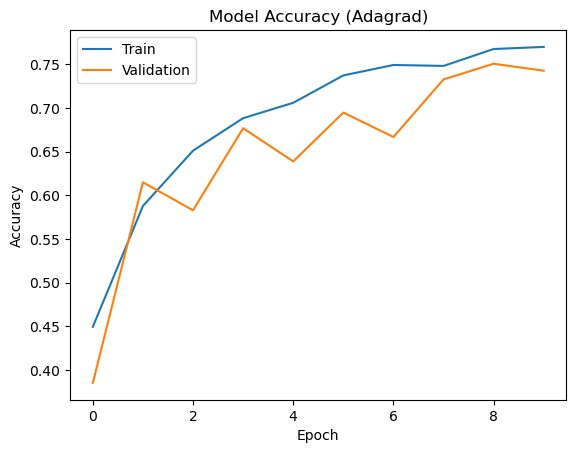

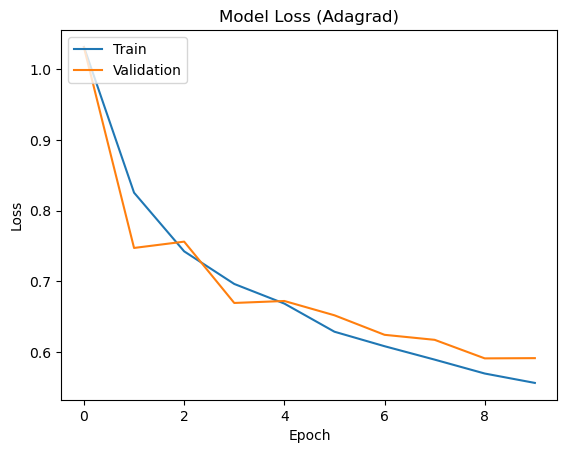

In [10]:
# Plot training & validation accuracy values (Adagrad)
plt.plot(history_adagrad.history['accuracy'])
plt.plot(history_adagrad.history['val_accuracy'])
plt.title('Model Accuracy (Adagrad)')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values (Adagrad)
plt.plot(history_adagrad.history['loss'])
plt.plot(history_adagrad.history['val_loss'])
plt.title('Model Loss (Adagrad)')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 267ms/step


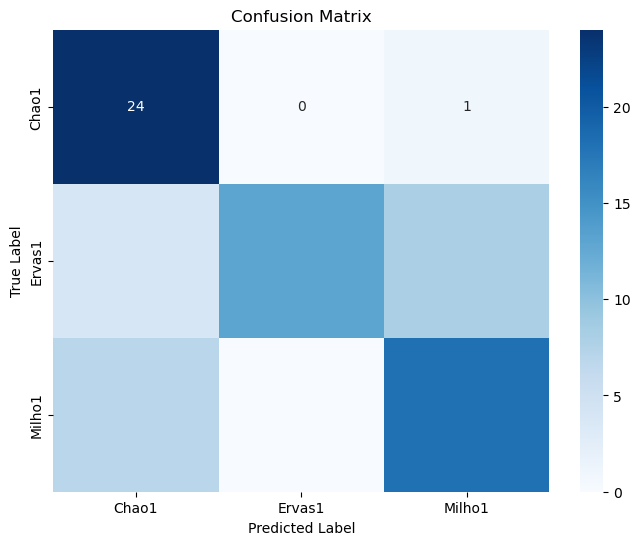

In [11]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()


# Tracer la matrice de confusion pour le modèle Adagrad
plot_confusion_matrix(model_adagrad, X_test, y_test)


In [6]:
from tensorflow.keras.layers import Dropout, BatchNormalization

def create_cnn_model_with_dropout(dropout_rate=0.2):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation='relu'),
        BatchNormalization(),  # Ajout de la normalisation par lots
        Dropout(dropout_rate),  # Ajout du dropout avec le taux spécifié
        layers.Dense(3, activation='softmax')  # 3 classes de sortie
    ])

    model.compile(optimizer='Adagrad',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [7]:
# Créer le modèle avec Dropout (taux de 0.2)
model_dropout_02 = create_cnn_model_with_dropout(dropout_rate=0.2)
history_dropout_02 = model_dropout_02.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 214s 1s/step - accuracy: 0.6107 - loss: 0.8448 - val_accuracy: 0.5449 - val_loss: 0.9275
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 192s 1s/step - accuracy: 0.7496 - loss: 0.6380 - val_accuracy: 0.5489 - val_loss: 0.8896
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 195s 1s/step - accuracy: 0.7979 - loss: 0.5254 - val_accuracy: 0.6986 - val_loss: 0.7083
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.8375 - loss: 0.4574 - val_accuracy: 0.7206 - val_loss: 0.6464
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 223s 2s/step - accuracy: 0.8672 - loss: 0.3659 - val_accuracy: 0.6786 - val_loss: 0.7093
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 215s 1s/step - accuracy: 0.9090 - loss: 0.3113 - val_accuracy: 0.5828 - val_loss: 0.9085
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 218s 2s/step - accuracy: 0.9335 - loss: 0.2483 - val_accuracy: 0.6507 - val_loss: 0.7871
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 214s 1s/step - accuracy: 0.9463 - loss: 0.2174 - val_accu

In [11]:
y_test_categorical = to_categorical(y_test)
test_loss_adagrad, test_accuracy_adagrad = model_dropout_02.evaluate(X_test, y_test)
print(f"Test Accuracy (Adagrad): {test_accuracy_adagrad}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.8079 - loss: 0.5501
Test Accuracy (Adagrad): 0.8266666531562805


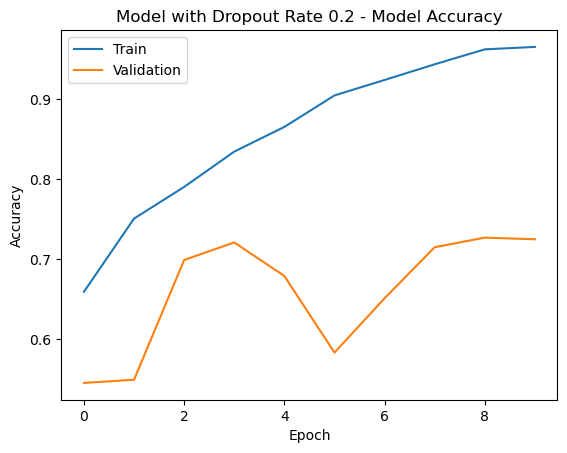

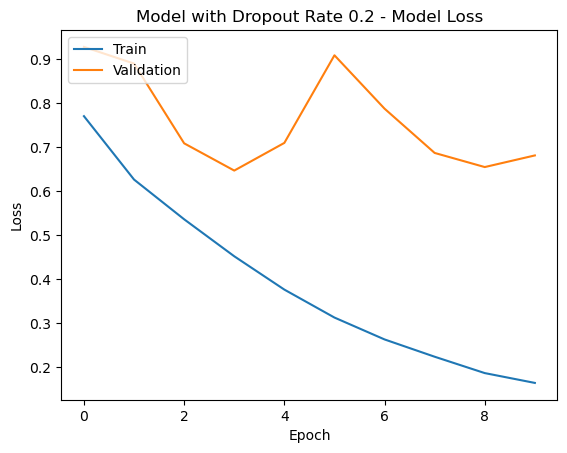

In [12]:
import matplotlib.pyplot as plt

def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

# Plot learning curves for model with Dropout rate 0.2
plot_learning_curves(history_dropout_02, 'Model with Dropout Rate 0.2')

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 316ms/step


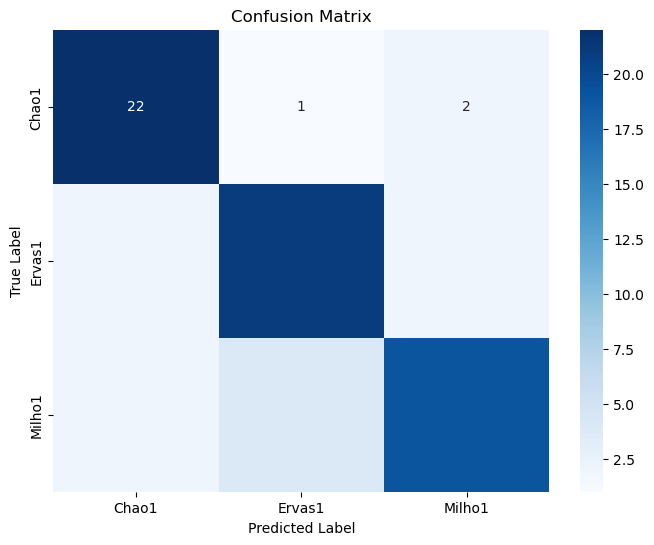

In [14]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

# Tracer la matrice de confusion pour le modèle Adagrad
plot_confusion_matrix(model_dropout_02, X_test, y_test)


In [15]:
# Créer le modèle avec Dropout (taux de 0.5)
model_dropout_02 = create_cnn_model_with_dropout(dropout_rate=0.5)
history_dropout_02 = model_dropout_02.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

/Volumes/BOOTCAMP/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Epoch 1/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.5888 - loss: 0.8936 - val_accuracy: 0.5130 - val_loss: 0.9841
Epoch 2/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 197s 1s/step - accuracy: 0.7213 - loss: 0.6724 - val_accuracy: 0.6866 - val_loss: 0.8331
Epoch 3/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 198s 1s/step - accuracy: 0.7568 - loss: 0.5919 - val_accuracy: 0.7625 - val_loss: 0.6918
Epoch 4/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.7957 - loss: 0.5060 - val_accuracy: 0.7166 - val_loss: 0.6187
Epoch 5/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 202s 1s/step - accuracy: 0.8284 - loss: 0.4449 - val_accuracy: 0.7645 - val_loss: 0.5719
Epoch 6/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 214s 1s/step - accuracy: 0.8668 - loss: 0.3841 - val_accuracy: 0.7824 - val_loss: 0.5066
Epoch 7/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 209s 1s/step - accuracy: 0.8763 - loss: 0.3612 - val_accuracy: 0.7405 - val_loss: 0.5593
Epoch 8/10
144/144 ━━━━━━━━━━━━━━━━━━━━ 219s 2s/step - accuracy: 0.9024 - loss: 0.3159 - val_accu

In [16]:
#Évaluer le modèle sur les données de test
test_loss_adagrad, test_accuracy_adagrad = model_dropout_02.evaluate(X_test, y_test)
print(f"Test Accuracy (Adagrad): {test_accuracy_adagrad}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 261ms/step - accuracy: 0.8051 - loss: 0.5327
Test Accuracy (Adagrad): 0.8133333325386047


In [19]:
import matplotlib.pyplot as plt

def plot_learning_curves(history, title):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(title + ' - Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(title + ' - Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()



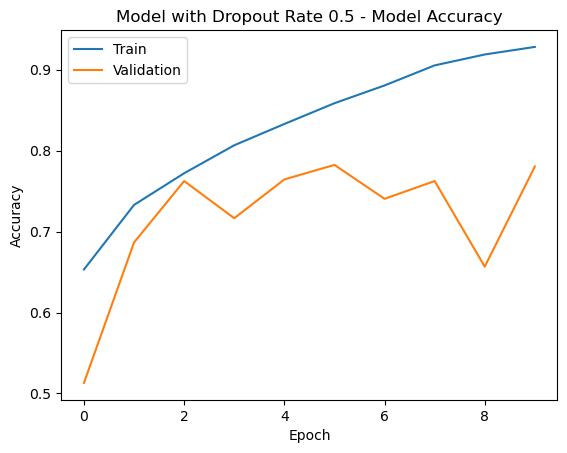

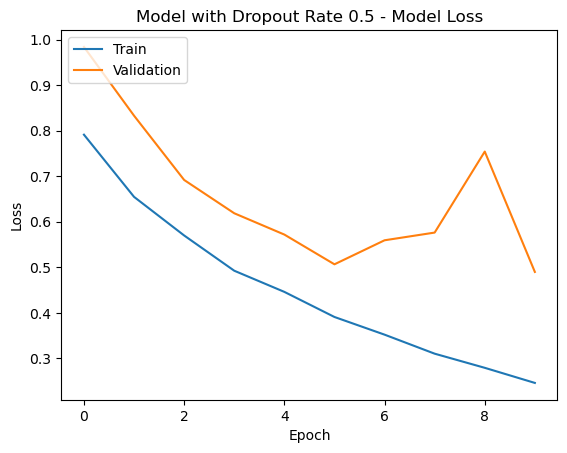

In [17]:
# Plot learning curves for model with Dropout rate 0.2
plot_learning_curves(history_dropout_02, 'Model with Dropout Rate 0.5')

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 284ms/step


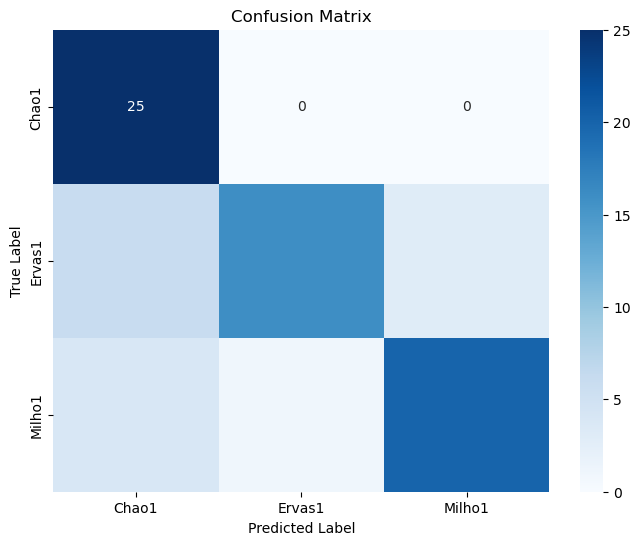

In [18]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Fonction pour tracer la matrice de confusion
def plot_confusion_matrix(model, X_test, y_test):
    # Prédictions sur les données de test
    y_pred = np.argmax(model.predict(X_test), axis=-1)

    # Calcul de la matrice de confusion
    cm = confusion_matrix(y_test, y_pred)

    # Affichage de la matrice de confusion sous forme de heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

# Tracer la matrice de confusion pour le modèle Adagrad
plot_confusion_matrix(model_dropout_02, X_test, y_test)

In [ ]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adagrad

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adagrad(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

In [ ]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

In [ ]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [ ]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adagrad

# Charger le modèle VGG16 pré-entraîné (poids ImageNet)
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle VGG16
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à notre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur Adam et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adagrad(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec les données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))

In [ ]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

In [ ]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()


In [ ]:
from tensorflow.keras.applications import Xception  # Importer Xception
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adagrad

# Charger le modèle Xception pré-entraîné (poids ImageNet)
base_model = Xception(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Congeler les couches du modèle Xception
for layer in base_model.layers:
    layer.trainable = False

# Ajouter une nouvelle couche dense de classification adaptée à votre problème
x = Flatten()(base_model.output)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)  # Ajouter une couche Dropout avec un taux de 0.5
predictions = Dense(3, activation='softmax')(x)

# Créer le modèle final
model = Model(inputs=base_model.input, outputs=predictions)

# Compiler le modèle avec l'optimiseur RMSprop et la fonction de perte sparse categorical crossentropy
model.compile(optimizer=Adagrad(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entraîner le modèle avec vos données d'entraînement
history = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_val, y_val))


In [ ]:
# Évaluer le modèle sur les données de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Accuracy on test data:", test_accuracy)

In [ ]:
import matplotlib.pyplot as plt

# Tracer la perte d'entraînement et de validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Tracer la précision d'entraînement et de validation
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Obtenir les prédictions du modèle sur les données de test
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Créer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# Afficher la matrice de confusion sous forme de heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Classe Prédite')
plt.ylabel('Classe Vraie')
plt.title('Matrice de Confusion')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Sélectionner quelques images de chaque classe à partir des données de test
num_images_per_class = 3  # Nombre d'images à sélectionner par classe
selected_images = []
selected_labels = []
selected_probabilities = []

# Remplacer X_test et y_test par vos données de test
for class_label in range(3):  # Remplacer 4 par le nombre total de classes
    class_indices = np.where(y_test == class_label)[0]
    if len(class_indices) >= num_images_per_class:
        selected_indices = np.random.choice(class_indices, num_images_per_class, replace=False)
        selected_images.extend(X_test[selected_indices])
        selected_labels.extend(y_test[selected_indices])
        predictions = model.predict(X_test[selected_indices])
        max_probabilities = np.max(predictions, axis=1)
        selected_probabilities.extend(max_probabilities)

selected_images = np.array(selected_images)
selected_labels = np.array(selected_labels)
selected_probabilities = np.array(selected_probabilities)

# Afficher les images avec les étiquettes prédites et les probabilités correspondantes
class_names = ["Chao1", "Ervas", "Milho"]  # Remplacer par les noms de vos classes
plt.figure(figsize=(12, 8))
for i in range(len(selected_images)):
    plt.subplot(num_images_per_class, len(class_names), i + 1)
    plt.imshow(selected_images[i])
    plt.title(f"Predicted: {class_names[selected_labels[i]]}\n"
              f"Probability: {selected_probabilities[i]:.4f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Sélectionnez une image à expliquer (remplacez cela par votre propre image)
image_to_explain = X_test[0]  # Par exemple, prenons la première image de vos données de test

# Définissez la fonction predict_proba qui prend en entrée une image et renvoie les prédictions de votre modèle
def predict_proba(images):
    # Prétraitez les images si nécessaire (par exemple, normalisez-les)
    preprocessed_images = images.astype(np.float32) / 255.0  # Normalisation
    # Utilisez votre modèle pour prédire les probabilités
    return model.predict(preprocessed_images)

# Initialisez une instance de LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Expliquez l'instance en appelant explain_instance()
explanation = explainer.explain_instance(image_to_explain, predict_proba, top_labels=5, hide_color=0, num_samples=1000)

# Affichez les superpixels explicatifs
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.show()
